In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
%matplotlib inline
from matplotlib import pyplot as plt
import pylab

**Question 1**

Image height= 1038 px, and width= 564 px and data type: uint8


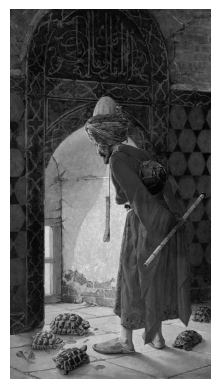

In [ ]:
# Read the image in grayscale mode using OpenCV library
gray_image = cv2.imread('/content/drive/MyDrive/q1_kaplumbaga_terbiyecisi_osman_hamdi_bey.jpg', cv2.IMREAD_GRAYSCALE)

# Get the height and width of the image
height, width = gray_image.shape

# Print information about the image
print("Image height=", height, "px, and width=", width, "px and data type:", gray_image.dtype)

# Display the grayscale image using Matplotlib
plt.imshow(gray_image,'gray')
plt.axis('off')
plt.show()

In [ ]:

def sigmoid_mapping_function(I, a, b):
    # Sigmoid-like mapping function
    return 1 -( 1 / (1 + np.exp(-a * (I - b))))

def transform(gray_image, a, b):
    # Nonlinear transformation for the red channel
    channelimg = np.zeros_like(gray_image,  dtype=np.float64)
    rows, cols = gray_image.shape
    minx=gray_image.min()
    maxx=gray_image.max()

    for i in range(rows):
      for j in range(cols):
         # Normalize pixel intensity to the range [0, 1]
        intensity = (gray_image[i, j] - minx ) /( maxx - minx )
         # Apply sigmoid mapping function
        mapped_value = sigmoid_mapping_function(intensity, a, b)
        channelimg[i,j] = mapped_value
    return channelimg


def create_colored_image(gray_image, a, b):
  # Initialize channels for red, green, and blue
  red_channel = np.zeros_like(gray_image,  dtype=np.float64)
  green_channel = np.zeros_like(gray_image,  dtype=np.float64)
  blue_channel = np.zeros_like(gray_image,  dtype=np.float64)

  # Transform the gray image using the sigmoid-like mapping
  sigmoidmatrix= transform(gray_image,a,b)

   # Define colors for mapping
  darkpurple=np.array([74, 21, 148])/255
  brightorange=np.array([255,120,0])/255
  rows, cols = sigmoidmatrix.shape

  for i in range(rows):
    for j in range(cols):
      t = sigmoidmatrix[i, j]
      # Linear combination of colors based on sigmoid-transformed values
      red_channel[i,j] = t*darkpurple[0] +(1-t)*brightorange[0]
      green_channel[i,j] = t*darkpurple[1] +(1-t)*brightorange[1]
      blue_channel[i,j] = t*darkpurple[2] +(1-t)*brightorange[2]



  # Combine channels to form the colored image
  colored_image = np.stack([red_channel, green_channel, blue_channel], axis=-1)



  return colored_image


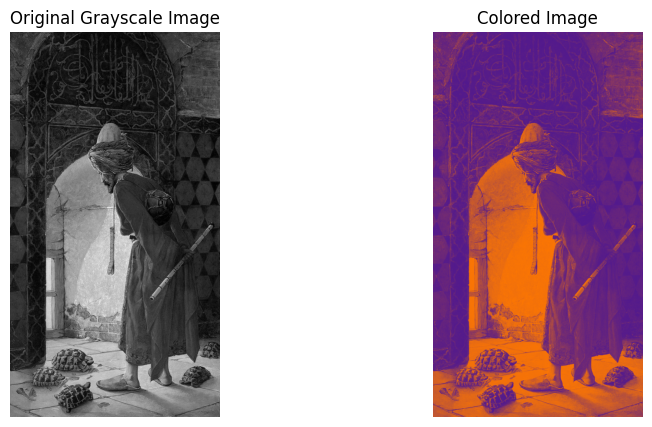

In [ ]:
a = 8
b = 0.4
# Create the colored image
colorized_image = create_colored_image(gray_image,a,b)

# Display the original grayscale image and the colored image
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Original Grayscale Image')
plt.imshow(gray_image, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Colored Image')
plt.imshow(colorized_image)
plt.axis('off')

plt.show()

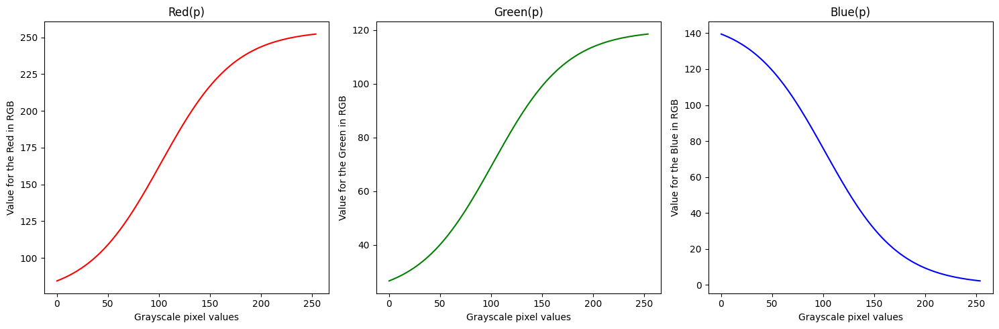

In [ ]:
# Find the minimum and maximum pixel values in the grayscale image
colorized_image_min=gray_image.min()
colorized_image_max=gray_image.max()

# Create a list of pixel values ranging from the minimum to the maximum
pixel_values=[]
for i in range(colorized_image_min, colorized_image_max):
  pixel_values.append(i)

# Define functions to calculate the RGB values for a given pixel intensity
def red(p, max, min):

  norm_p = (p - min) / (max - min)
  sigmoid_p = 1 / (1 + np.exp(-7 *(norm_p-0.4)))
  red = (1 - sigmoid_p)*(74/255) + sigmoid_p*(255/255)

  return red

def green(p, max, min):

  norm_p = (p - min) / (max - min)
  sigmoid_p = 1 / (1 + np.exp(-7 *(norm_p-0.4)))
  green = (1 - sigmoid_p)*(21/255) + sigmoid_p*(120/255)

  return green

def blue(p, max, min):

  norm_p = (p - min) / (max - min)
  sigmoid_p = 1 / (1 + np.exp(-7 *(norm_p-0.4)))
  blue = (1 - sigmoid_p)*(148/255) + sigmoid_p*(0/255)

  return blue

# Calculate the RGB values for each pixel intensity in the specified range
red_pixels=[]
for j in range(colorized_image_min, colorized_image_max):
  red_pixels.append(255*red(j, colorized_image_max, colorized_image_min))

green_pixels=[]
for j in range(colorized_image_min, colorized_image_max):
  green_pixels.append(255*green(j, colorized_image_max, colorized_image_min))

blue_pixels=[]
for j in range(colorized_image_min, colorized_image_max):
  blue_pixels.append(255*blue(j, colorized_image_max, colorized_image_min))

# Create subplots
plt.figure(figsize=(15, 5))

# Subplot for Red
plt.subplot(1, 3, 1)
plt.plot(pixel_values, red_pixels, linestyle='-', color='red')
plt.xlabel('Grayscale pixel values')
plt.ylabel('Value for the Red in RGB')
plt.title('Red(p)')

# Subplot for Green
plt.subplot(1, 3, 2)
plt.plot(pixel_values, green_pixels, linestyle='-', color='green')
plt.xlabel('Grayscale pixel values')
plt.ylabel('Value for the Green in RGB')
plt.title('Green(p)')

# Subplot for Blue
plt.subplot(1, 3, 3)
plt.plot(pixel_values, blue_pixels, linestyle='-', color='blue')
plt.xlabel('Grayscale pixel values')
plt.ylabel('Value for the Blue in RGB')
plt.title('Blue(p)')

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


**Question 2**

Image height= 166 px, and width= 187 px and data type: uint8


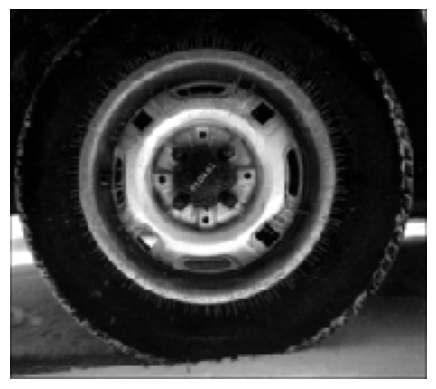

In [ ]:
# Read the image in grayscale mode using OpenCV library
gray_image2 = cv2.imread('/content/drive/MyDrive/q2_wheel.png', cv2.IMREAD_GRAYSCALE)

# Get the height and width of the image
height, width = gray_image2.shape

# Print information about the image
print("Image height=", height, "px, and width=", width, "px and data type:", gray_image2.dtype)

# Display the binary image using Matplotlib
plt.imshow(gray_image2,'gray')
plt.axis('off')
plt.show()

In [ ]:
def erosion(image, se):
  # Create an array of zeros with the same shape as the input image
  result = np.zeros_like(image)

  # Get the number of rows and columns in the structuring element (se)
  se_rows, se_cols = se.shape

  # Get the number of rows and columns in the input image
  img_rows, img_cols = image.shape

  # Iterate the SE over the input image
  for row in range(img_rows - se_rows + 1):
      for col in range(img_cols - se_cols + 1):

        # Extract the region of interest from the input image
        region = image[row:row + se_rows, col:col + se_cols]

        # Calculate the minimum value in the region where the structuring element is 1
        result[row + se_rows // 2, col + se_cols // 2] = np.min(region[se == 1])

  # Return the result of erosion
  return result



In [ ]:
def geodesic_erosion(marker, mask):
   # Structuring element for erosion
  B = np.array([[1, 1, 1],
              [1, 1, 1],
              [1, 1, 1]])

  # Perform erosion on the marker using the structuring element B
  marker_erosion = erosion(marker, B)
  # Take the element-wise maximum between the eroded marker and the mask
  result = np.maximum(marker_erosion, mask)

  return result


In [ ]:
def reconstruction_by_erosion(marker, mask):

  # Initialize the result using geodesic erosion
  result = geodesic_erosion(marker, mask)
  # Iterate until convergence
  while True:
    # Perform geodesic erosion on the current result
    result_new = geodesic_erosion(result, mask)
    # Check if the result has converged (no change)
    if np.array_equal(result, result_new):
      break
    # Update the result for the next iteration
    result = result_new

  return result



In [ ]:

def border_preserve_max(image):
    # Create a copy of the input image to avoid modifying the original
    result = np.copy(image)

    # Set interior pixels to the maximum value
    result[1:-1, 1:-1] = np.max(image)

    return result



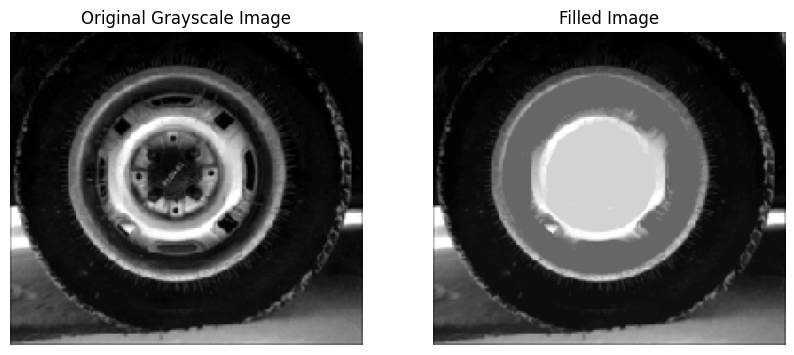

In [ ]:
tempimage=border_preserve_max(gray_image2)
filledimage=reconstruction_by_erosion(tempimage,gray_image2)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Original Grayscale Image')
plt.imshow(gray_image2, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Filled Image')
plt.imshow(filledimage,'gray')
plt.axis('off')

plt.show()

**Question 3**

Image height= 544 px, and width= 900 px and data type: uint8


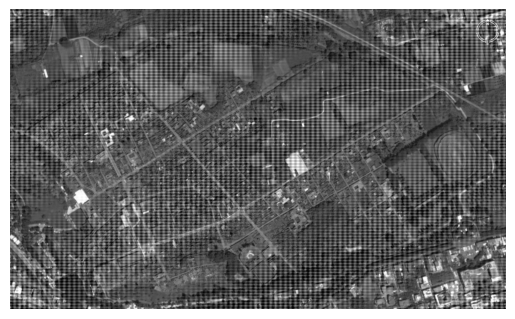

In [ ]:
# Read the image in grayscale mode using OpenCV library
gray_image3 = cv2.imread('/content/drive/MyDrive/q3_pompeii.png', cv2.IMREAD_GRAYSCALE)

# Get the height and width of the image
height, width = gray_image3.shape

# Print information about the image
print("Image height=", height, "px, and width=", width, "px and data type:", gray_image3.dtype)

# Display the binary image using Matplotlib
plt.imshow(gray_image3,'gray')
plt.axis('off')
plt.show()

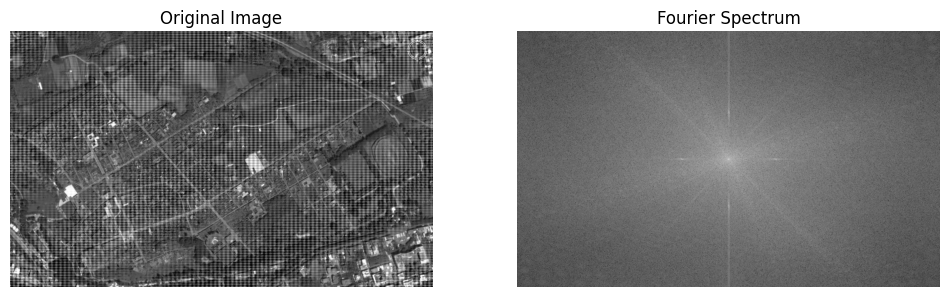

In [ ]:
def visualize_fourier_spectrum(image):
    # Compute the 2D Fourier Transform of the image
    f_transform = np.fft.fft2(image)
    f_transform_shifted = np.fft.fftshift(f_transform)

    # Calculate the magnitude spectrum
    magnitude_spectrum = np.abs(f_transform_shifted)

    # Display the original image and its Fourier spectrum
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Original Image')
    plt.imshow(image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Fourier Spectrum')
    plt.imshow(np.log(1 + magnitude_spectrum), cmap='gray')  # Log scale for better visualization
    plt.axis('off')

    plt.show()

visualize_fourier_spectrum(gray_image3)

In [ ]:

def band_reject_filter(image):
    # Compute the 2D Fourier Transform of the image
    f_transform = np.fft.fft2(image)
    f_transform_shifted = np.fft.fftshift(f_transform)

    # Get image dimensions
    rows, cols = f_transform_shifted.shape

    # Create a band-reject filter
    filter_mask = np.ones((rows, cols), dtype=np.uint8)


    D0 = 100
    W = 12

    # Band-reject filter function
    for u in range(rows):
      for v in range(cols):
        D = np.sqrt((u - rows / 2) ** 2 + (v - cols / 2) ** 2)
        if(D < (D0 - W/2)):
          filter_mask[u, v] = 1
        if((D0 - W/2) <= D <= (D0 + W/2)):
          filter_mask[u, v] = 0
        if(D > (D0 + W/2)):
          filter_mask[u, v] = 1

    # Apply the band-reject filter to the frequency domain image
    f_transform_shifted_filtered = f_transform_shifted * filter_mask

    # Inverse Fourier transform to obtain the filtered image
    G = np.fft.ifftshift(f_transform_shifted_filtered)
    denoised_image = np.abs(np.fft.ifft2(G))

    return denoised_image



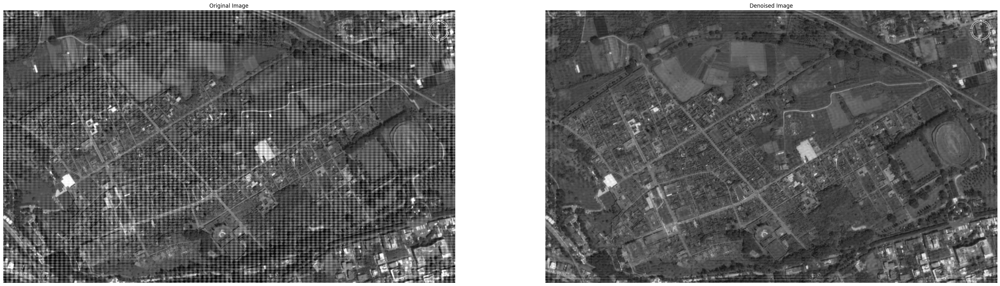

In [ ]:
# Apply band-reject filter to denoise the image

denoised_image = band_reject_filter(gray_image3)

# Display the corrupted and denoised images
plt.figure(figsize=(40, 40))

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(gray_image3, cmap='gray')
plt.axis('off')


plt.subplot(1, 2, 2)
plt.title('Denoised Image')
plt.imshow(denoised_image, cmap='gray')
plt.axis('off')

plt.show()

**Question 4**

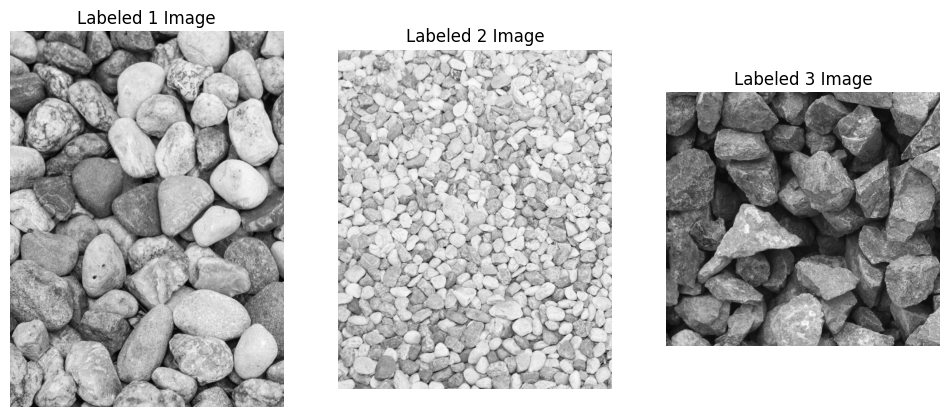

In [47]:

# Read the labeled three gray images using OpenCV library

labeled1 = cv2.imread('/content/drive/MyDrive/labeled-1.jpg', cv2.IMREAD_GRAYSCALE)
labeled2 = cv2.imread('/content/drive/MyDrive/labeled-2.jpg', cv2.IMREAD_GRAYSCALE)
labeled3 = cv2.imread('/content/drive/MyDrive/labeled-3.jpg', cv2.IMREAD_GRAYSCALE)

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.title('Labeled 1 Image')
plt.imshow(labeled1, cmap='gray')
plt.axis('off')


plt.subplot(1, 3, 2)
plt.title('Labeled 2 Image')
plt.imshow(labeled2, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title('Labeled 3 Image')
plt.imshow(labeled3, cmap='gray')
plt.axis('off')
plt.show()

# Show the subplots
plt.show()


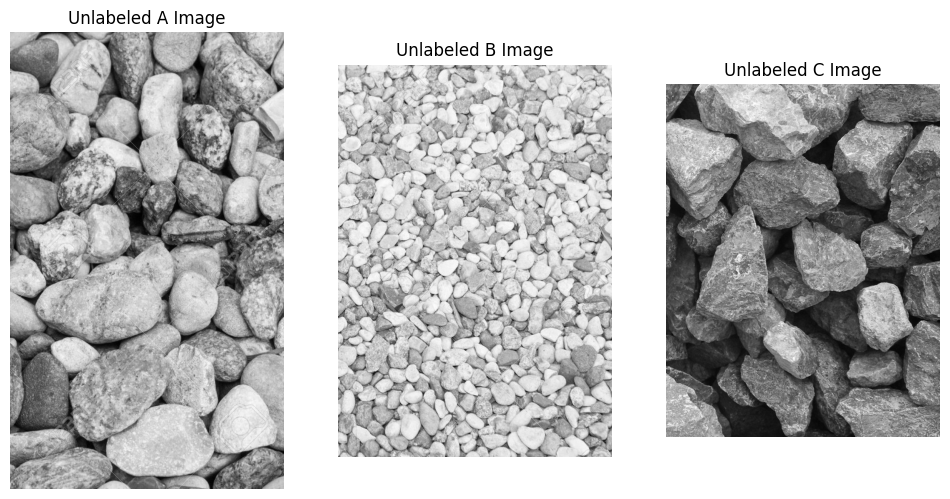

In [48]:

# Read the unlabeled three gray images using OpenCV library
unlabeled1 = cv2.imread('/content/drive/MyDrive/unlabeled-A.jpg', cv2.IMREAD_GRAYSCALE)
unlabeled2 = cv2.imread('/content/drive/MyDrive/unlabeled-B.jpg', cv2.IMREAD_GRAYSCALE)
unlabeled3 = cv2.imread('/content/drive/MyDrive/unlabeled-C.jpg', cv2.IMREAD_GRAYSCALE)

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.title('Unlabeled A Image')
plt.imshow(unlabeled1, cmap='gray')
plt.axis('off')


plt.subplot(1, 3, 2)
plt.title('Unlabeled B Image')
plt.imshow(unlabeled2, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title('Unlabeled C Image')
plt.imshow(unlabeled3, cmap='gray')
plt.axis('off')
plt.show()

# Show the subplots
plt.show()

In [49]:
def pad_image(image, pad_size):

    padded_image = np.pad(image, pad_size, mode='constant', constant_values=0)
    return padded_image


In [50]:
def erosion(image, se):

  # Get the number of rows and columns in the structuring element (se)
  se_rows, se_cols = se.shape
  se_size= se_rows

  padding = se_size // 2
  padded_image = pad_image(image,padding)
  result = np.zeros_like(padded_image)

  img_rows, img_cols = padded_image.shape

  # Iterate the SE over the padded image
  for row in range(padding,img_rows - padding):
      for col in range(padding,img_cols - padding):

        # Extract the region of interest from the input image
        region = padded_image[row-padding:row + padding +1, col-padding:col + padding +1]

        # Calculate the minimum value in the region where the structuring element is 1
        result[row, col] = np.min(region[se == 1])

  # Return the result of erosion
  return result[padding:-padding, padding:-padding]

In [51]:
def dilation(image, se):

  # Get the number of rows and columns in the structuring element (se)
  se_rows, se_cols = se.shape
  se_size= se_rows

  padding = se_size // 2
  padded_image = pad_image(image,padding)
  result = np.zeros_like(padded_image)

  img_rows, img_cols = padded_image.shape

  # Iterate the SE over the input image
  for row in range(padding,img_rows - padding):
      for col in range(padding,img_cols - padding):

        # Extract the region of interest from the input image
        region = padded_image[row-padding:row + padding +1, col-padding:col + padding +1]

        # Calculate the max value in the region where the structuring element is 1
        result[row, col] = np.max(region[se == 1])

  # Return the result of dilation
  return result[padding:-padding, padding:-padding]

In [52]:
def opening(image, se):
    # Perform erosion on the input image using the specified structuring element (se)
    eroded_image = erosion(image, se)
    # Perform dilation on the eroded image using the same structuring element
    opened_image = dilation(eroded_image, se)
    # Return the result of the opening operation
    return opened_image

In [53]:
def circular_kernel(size):
  # Calculate the radius of the circular kernel
    r = size // 2
    # Generate a grid of y and x coordinates centered at (0, 0)
    y, x = np.ogrid[-r:r+1, -r:r+1]
    # Create a boolean mask for the circular region based on the distance from the center
    kernel = x**2 + y**2 <= r**2
    # Convert the boolean mask to binary (0 or 1) by typecasting to uint8
    kernel = kernel.astype(np.uint8)
    return kernel


In [57]:
def calculate_granulometry(image, sizes):
  # Initialize a list to store the granulometry results for each size
    granulometry_results = []
  # Iterate over each specified size
    for size in sizes:
       # Generate a circular kernel for the current size
        kernel = circular_kernel(size)
        # Perform opening on the input image using the circular kernel
        opened_image = opening(image, kernel)
        # Calculate the mean of the opened image and append to the results
        granulometry_results.append(np.mean(opened_image))
    # Return the list of granulometry results
    return granulometry_results

In [55]:
def euclidean(series1, series2):
    return np.linalg.norm(np.array(series1) - np.array(series2))


Unlabeled Image /content/drive/MyDrive/unlabeled-A.jpg:
 Image Labeled as Labeled 1 according to Euclidean distance


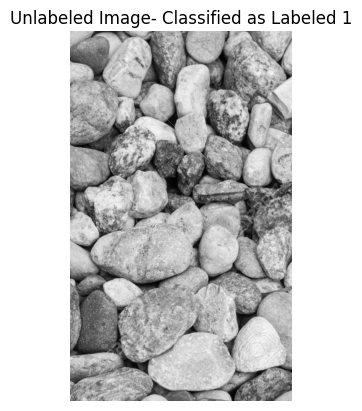


Unlabeled Image /content/drive/MyDrive/unlabeled-B.jpg:
 Image Labeled as Labeled 2 according to Euclidean distance


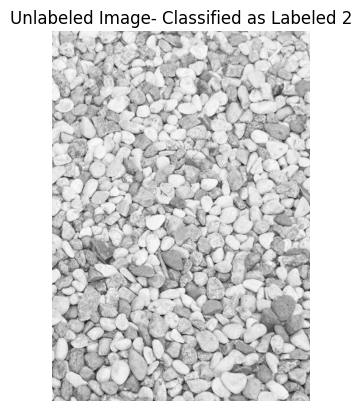


Unlabeled Image /content/drive/MyDrive/unlabeled-C.jpg:
 Image Labeled as Labeled 3 according to Euclidean distance


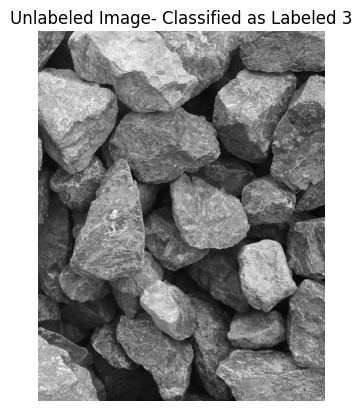

In [60]:
import matplotlib.image as mpimg
# Specify the circular kernel sizes
sizes = [20,30,40,50,60,70]

# Lists to store granulometry results for labeled and unlabeled images
# Perform granulometry calculation for labeled images
labeled_means = []
labeled_granulometry1 = calculate_granulometry(labeled1, sizes)
labeled_means.append(labeled_granulometry1)
labeled_granulometry2 = calculate_granulometry(labeled2, sizes)
labeled_means.append(labeled_granulometry2)
labeled_granulometry3 = calculate_granulometry(labeled3, sizes)
labeled_means.append(labeled_granulometry3)

# Perform granulometry calculation for unlabeled images
unlabeled_means = []
unlabeled_granulometry1 = calculate_granulometry(unlabeled1, sizes)
unlabeled_means.append(unlabeled_granulometry1)
unlabeled_granulometry2 = calculate_granulometry(unlabeled2, sizes)
unlabeled_means.append(unlabeled_granulometry2)
unlabeled_granulometry3 = calculate_granulometry(unlabeled3, sizes)
unlabeled_means.append(unlabeled_granulometry3)

unlabeled_images_paths = ["/content/drive/MyDrive/unlabeled-A.jpg", "/content/drive/MyDrive/unlabeled-B.jpg", "/content/drive/MyDrive/unlabeled-C.jpg"]

# Iterate over unlabeled images and compare with labeled images
for i, unlabeled_mean in enumerate(unlabeled_means):

    # Find the closest labeled image based on Euclidean distance
    euclidean_distances = [euclidean(np.array(unlabeled_mean), np.array(labeled_mean)) for labeled_mean in labeled_means]
    closest_euclidean = np.argmin(euclidean_distances) + 1

    # Show the unlabeled image
    unlabeled_image_path = unlabeled_images_paths[i]
    print(f"Unlabeled Image {unlabeled_image_path}:")
    print(f" Image Labeled as Labeled {closest_euclidean} according to Euclidean distance")

    img = mpimg.imread(unlabeled_image_path)
    plt.imshow(img , cmap='gray')
    plt.title(f"Unlabeled Image- Classified as Labeled {closest_euclidean}")
    plt.axis('off')
    plt.show()
    print()

**Question 4a**

In [65]:
def apply_tophat(image, se):
    opened_image = opening(image, se)
    return image - opened_image

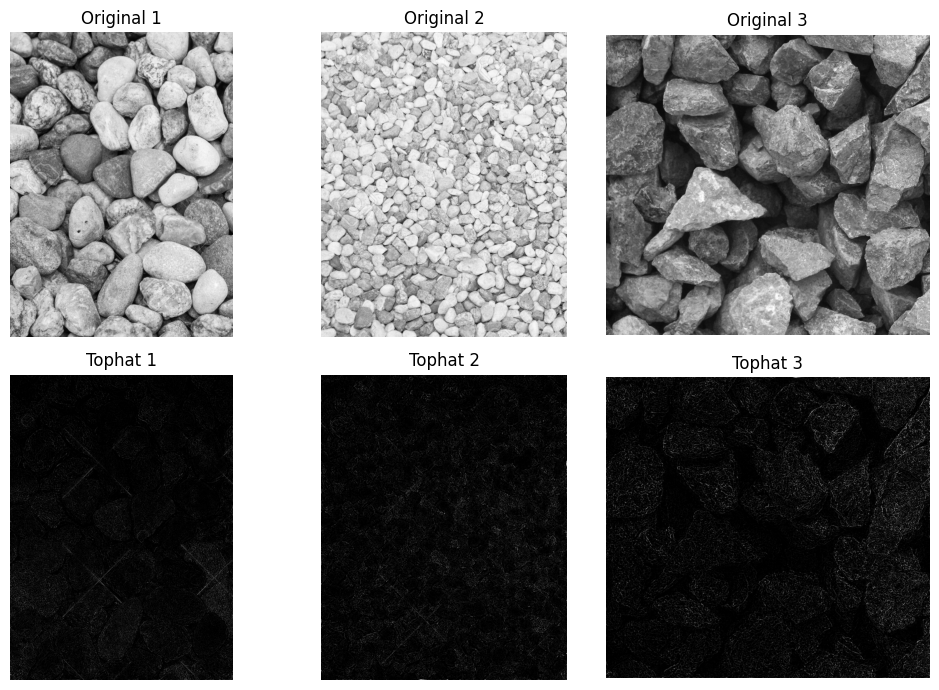

In [73]:

se = np.ones((3, 3), dtype=np.uint8)


# Apply the tophat function to each image
result1 = apply_tophat(labeled1, se)
result2 = apply_tophat(labeled2, se)
result3 = apply_tophat(labeled3, se)


# Plot the original and processed images using subplots
plt.figure(figsize=(10, 7))

# Original images
plt.subplot(2, 3, 1)
plt.imshow(labeled1, cmap='gray')
plt.title('Original 1')
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(labeled2, cmap='gray')
plt.title('Original 2')
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(labeled3, cmap='gray')
plt.title('Original 3')
plt.axis('off')

# Processed images
plt.subplot(2, 3, 4)
plt.imshow(result1, cmap='gray')
plt.title('Tophat 1')
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(result2, cmap='gray')
plt.title('Tophat 2')
plt.axis('off')

plt.subplot(2, 3, 6)
plt.imshow(result3, cmap='gray')
plt.title('Tophat 3')
plt.axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

**Question 4b**

Unlabeled Image /content/drive/MyDrive/unlabeled-A.jpg:
 Image Labeled as Labeled 1 according to Euclidean distance


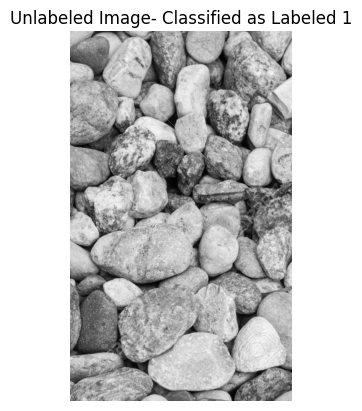


Unlabeled Image /content/drive/MyDrive/unlabeled-B.jpg:
 Image Labeled as Labeled 2 according to Euclidean distance


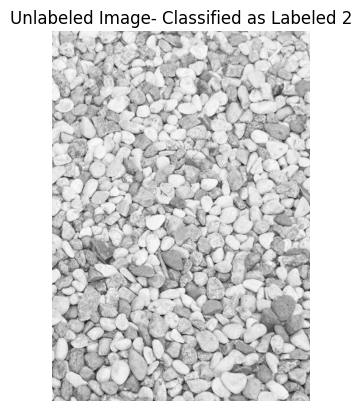


Unlabeled Image /content/drive/MyDrive/unlabeled-C.jpg:
 Image Labeled as Labeled 3 according to Euclidean distance


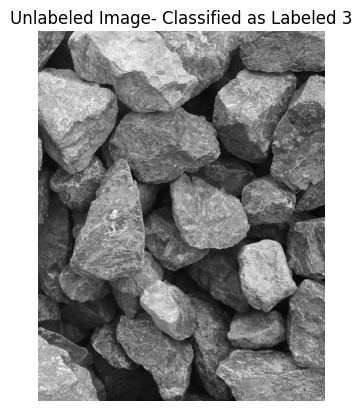

In [64]:
# Specify the new circular kernel sizes
sizes2 = [70,80,90,100,110,120]

# Lists to store granulometry results for labeled and unlabeled images with sizes2
# Perform granulometry calculation for labeled images with sizes2
labeled_means2 = []
labeled_granulometry12 = calculate_granulometry(labeled1, sizes2)
labeled_means2.append(labeled_granulometry12)
labeled_granulometry22 = calculate_granulometry(labeled2, sizes2)
labeled_means2.append(labeled_granulometry22)
labeled_granulometry32 = calculate_granulometry(labeled3, sizes2)
labeled_means2.append(labeled_granulometry32)

# Perform granulometry calculation for unlabeled images with sizes2
unlabeled_means2 = []
unlabeled_granulometry12 = calculate_granulometry(unlabeled1, sizes2)
unlabeled_means2.append(unlabeled_granulometry12)
unlabeled_granulometry22 = calculate_granulometry(unlabeled2, sizes2)
unlabeled_means2.append(unlabeled_granulometry22)
unlabeled_granulometry32 = calculate_granulometry(unlabeled3, sizes2)
unlabeled_means2.append(unlabeled_granulometry32)

# Iterate over unlabeled images and compare with labeled images using sizes2
for i, unlabeled_mean in enumerate(unlabeled_means2):
     # Calculate Euclidean distances between unlabeled and each labeled image with sizes2
    euclidean_distances = [euclidean(np.array(unlabeled_mean), np.array(labeled_mean)) for labeled_mean in labeled_means2]
     # Find the closest labeled image based on Euclidean distance
    closest_euclidean = np.argmin(euclidean_distances) + 1

    # Show the unlabeled image
    unlabeled_image_path = unlabeled_images_paths[i]
    print(f"Unlabeled Image {unlabeled_image_path}:")
    print(f" Image Labeled as Labeled {closest_euclidean} according to Euclidean distance")

    img = mpimg.imread(unlabeled_image_path)
    plt.imshow(img , cmap='gray')
    plt.title(f"Unlabeled Image- Classified as Labeled {closest_euclidean}")
    plt.axis('off')
    plt.show()
    print()

**Question 4d**

In [61]:
def manhattan(series1, series2):
    return np.sum(np.abs(np.array(series1) - np.array(series2)))

def chebyshev(series1, series2):
    return np.linalg.norm(np.array(series1) - np.array(series2), ord=np.inf)

Unlabeled Image /content/drive/MyDrive/unlabeled-A.jpg:
 Image Labeled as Labeled 1 according to Manhattan distance
 Image Labeled as Labeled 1 according to Chebyshev distance


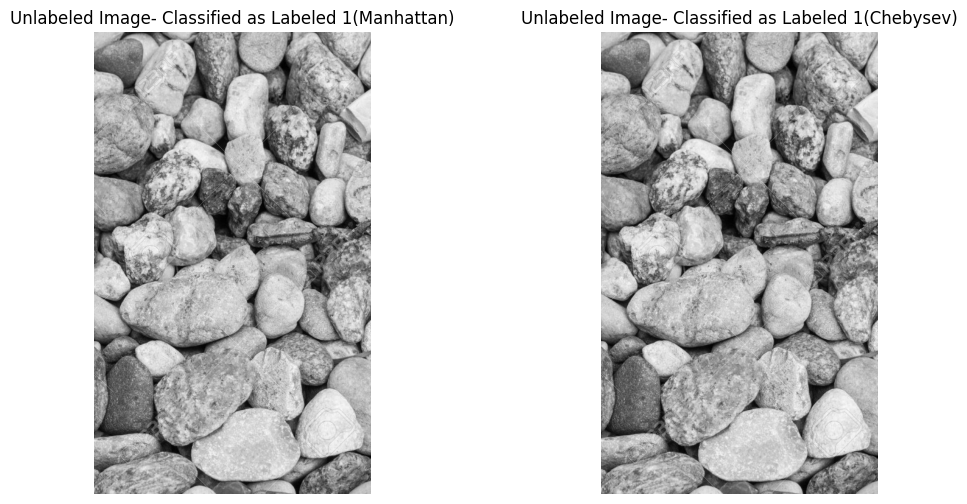


Unlabeled Image /content/drive/MyDrive/unlabeled-B.jpg:
 Image Labeled as Labeled 2 according to Manhattan distance
 Image Labeled as Labeled 2 according to Chebyshev distance


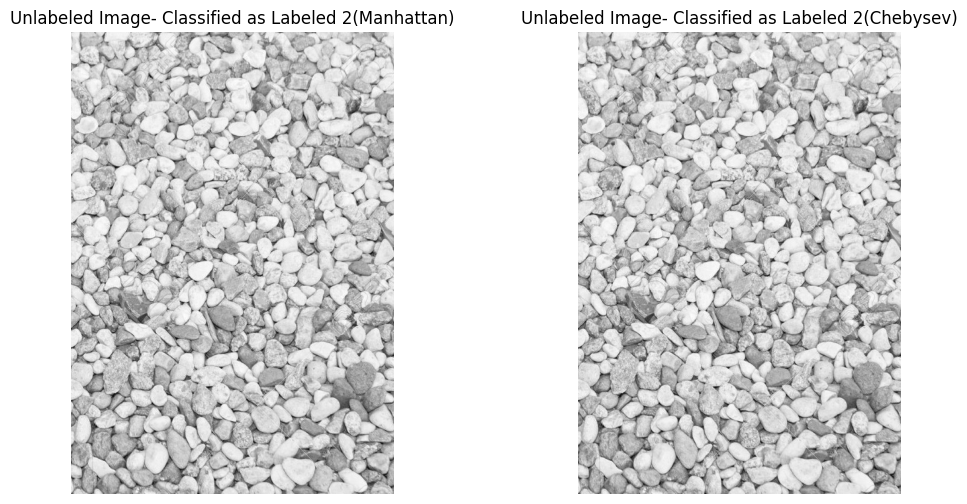


Unlabeled Image /content/drive/MyDrive/unlabeled-C.jpg:
 Image Labeled as Labeled 3 according to Manhattan distance
 Image Labeled as Labeled 3 according to Chebyshev distance


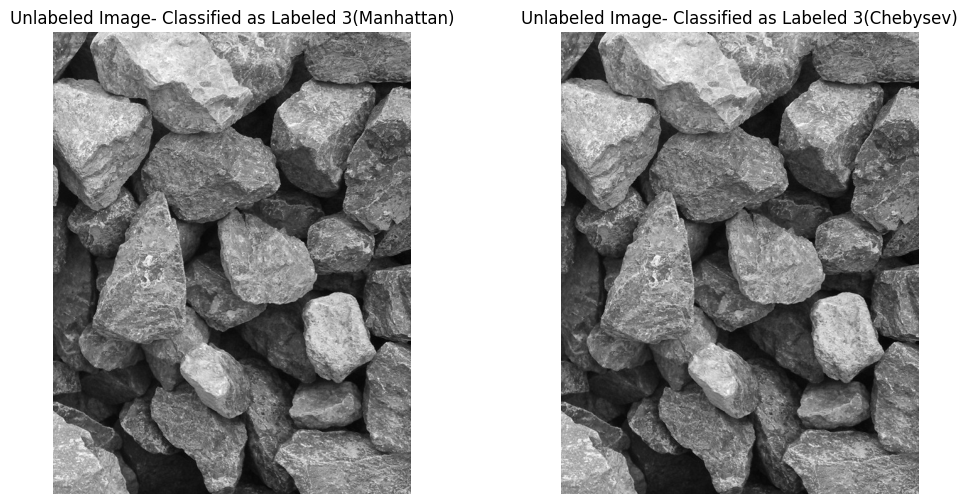

In [63]:
# Iterate over unlabeled images and compare with labeled images
for i, unlabeled_mean in enumerate(unlabeled_means):
     # Calculate Manhattan and Chebysev distances between unlabeled and each labeled image
    manhattan_distances = [manhattan(np.array(unlabeled_mean), np.array(labeled_mean)) for labeled_mean in labeled_means]
    chebyshev_distances = [chebyshev(np.array(unlabeled_mean), np.array(labeled_mean)) for labeled_mean in labeled_means]

    # Find the closest labeled image based on Manhattan and Chebysev distance
    closest_manhattan = np.argmin(manhattan_distances) + 1
    closest_chebyshev = np.argmin(chebyshev_distances) + 1

    # Show the unlabeled image
    unlabeled_image_path = unlabeled_images_paths[i]
    print(f"Unlabeled Image {unlabeled_image_path}:")
    print(f" Image Labeled as Labeled {closest_manhattan} according to Manhattan distance")
    print(f" Image Labeled as Labeled {closest_chebyshev} according to Chebyshev distance")

    img = mpimg.imread(unlabeled_image_path)
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(img , cmap='gray')
    plt.title(f"Unlabeled Image- Classified as Labeled {closest_manhattan}(Manhattan)")
    plt.axis('off')

    plt.subplot(1, 2,2)
    plt.imshow(img , cmap='gray')
    plt.title(f"Unlabeled Image- Classified as Labeled {closest_chebyshev}(Chebysev)")
    plt.axis('off')
    plt.show()
    print()

**Question 5**

In [ ]:

def add_colored_large_salt_and_pepper_noise(image, salt_prob, patch_size):
    noisy_image = np.copy(image)

    # Add salt and peper noise patches

    for i in range(0, image.shape[0], patch_size):
        for j in range(0, image.shape[1], patch_size):
            if np.random.rand() < salt_prob:
                random_color = np.random.randint(0, 256, size=(3,))
                noisy_image[i:i+patch_size, j:j+patch_size] = random_color

    return noisy_image



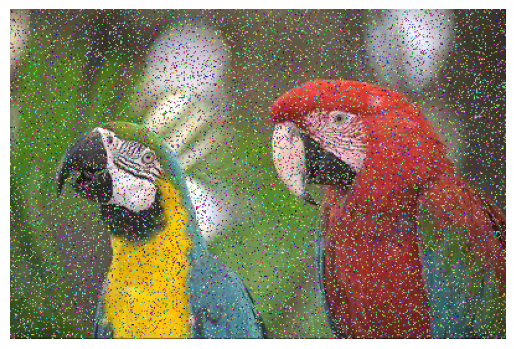

In [ ]:
# Read the image in grayscale mode using OpenCV library
input_image = cv2.imread('/content/drive/MyDrive/p5.jpg')

input_image_rgb = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)

input_image_final=add_colored_large_salt_and_pepper_noise(input_image_rgb,0.2,1)

# Display the binary image using Matplotlib
plt.imshow(input_image_final)
plt.axis('off')
plt.show()

In [ ]:
from scipy.ndimage import median_filter

def pad_image(image, pad_size):

    padded_image = np.pad(image, pad_size, mode='constant', constant_values=0)
    return padded_image


def median(image,size):
    padding = size // 2
    padded_image = pad_image(image, padding)
    filtered_image = np.zeros_like(image)

    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            # Extract the szexsize region of interest (ROI) from the padded image
            roi = padded_image[i:i + size, j:j + size]

            # Apply median filter to the ROI and set the result in the center pixel of the region
            filtered_image[i, j] = np.median(roi)

    return filtered_image

def median_filter_custom(image,size):
    filtered_image = np.zeros_like(image)

    for channel in range(image.shape[2]):
        channel_filtered = median(image[:, :, channel],size)
        filtered_image[:, :, channel] = channel_filtered

    return filtered_image





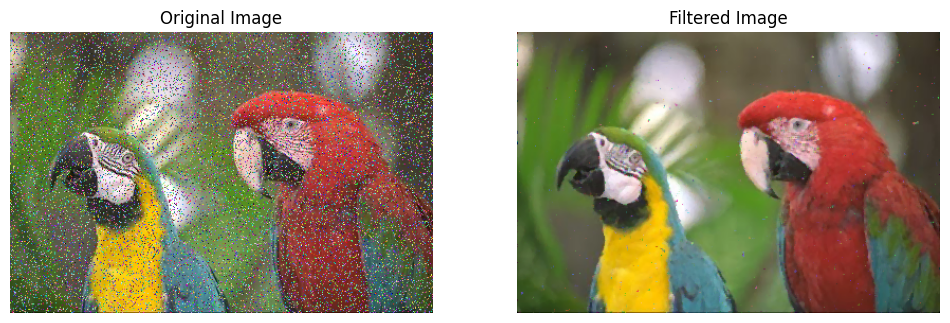

In [ ]:
filtered_image=median_filter_custom(input_image_final,size=3)


# Display the original, corrupted, and denoised images
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(input_image_final)
plt.axis('off')


plt.subplot(1, 2, 2)
plt.title('Filtered Image')
plt.imshow(filtered_image)
plt.axis('off')

plt.show()

In [ ]:
def lexicographical_ordering(pixel_matrix,size) :

    flattened_vector = pixel_matrix.reshape((-1, 3))
    # Extract separate vectors for red, green, and blue
    red_vector = np.zeros(size**2)
    green_vector = np.zeros(size**2)
    blue_vector = np.zeros(size**2)

    for i in range(size**2):
      red_vector[i] = flattened_vector[i][0]

    for i in range(size**2):
      green_vector[i] = flattened_vector[i][1]

    for i in range(size**2):
      blue_vector[i] = flattened_vector[i][2]

    # Use numpy.lexsort to sort the vectors based on the red values
    sorted_indices = np.lexsort((blue_vector, green_vector, red_vector))
    median=len(sorted_indices)//2
    # Get the index of the median value
    median_index = sorted_indices[median]

    # Get the RGB value of the median pixel
    median_pixel = flattened_vector[median_index]

    return median_pixel


def vector_median_filter(image,size):

    # Pad the image with a border of size
    padding = size // 2
    padded_image = np.pad(image, ((padding, padding), (padding, padding), (0, 0)), mode='constant', constant_values=0)

    filtered_image = np.zeros_like(image)

    for i in range(image.shape[0] ):
        for j in range(image.shape[1]):
            # Extract the sizexsize region of interest (ROI) from the padded image
            centerpixel=image[i,j]
            roi = padded_image[i:i+size, j:j+size, :]

            # Sort the vectors lexicographically
            median = lexicographical_ordering(roi,size)
            # Set the result in the center pixel of the region
            filtered_image[i, j] = median

    return filtered_image

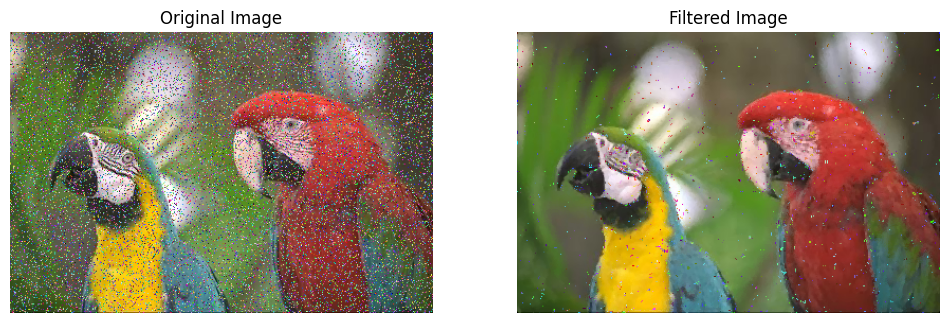

In [ ]:
filtered_vector_image=vector_median_filter(input_image_final,size=3)


# Display the original, corrupted, and denoised images
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(input_image_final)
plt.axis('off')


plt.subplot(1, 2, 2)
plt.title('Filtered Image')
plt.imshow(filtered_vector_image)
plt.axis('off')

plt.show()

In [ ]:
def bitmix_ordering(arr):

    x = arr[0]
    y = arr[1]
    z = arr[2]

    x = (x | (x << 16)) & 0x030000FF
    x = (x | (x << 8)) & 0x0300F00F
    x = (x | (x << 4)) & 0x030C30C3
    x = (x | (x << 2)) & 0x09249249

    y = (y | (y << 16)) & 0x030000FF
    y = (y | (y << 8)) & 0x0300F00F
    y = (y | (y << 4)) & 0x030C30C3
    y = (y | (y << 2)) & 0x09249249

    z = (z | (z << 16)) & 0x030000FF
    z = (z | (z << 8)) & 0x0300F00F
    z = (z | (z << 4)) & 0x030C30C3
    z = (z | (z << 2)) & 0x09249249

    return (x | (y << 1) | (z << 2))

def vector_median_filter2(image,size):

    padding = size // 2
    padded_image = np.pad(image, ((padding, padding), (padding, padding), (0, 0)), mode='constant', constant_values=0)

    filtered_image = np.zeros_like(image)

    for i in range( image.shape[0]):
        for j in range( image.shape[1]):
            # Extract the sizexsize region of interest (ROI) from the padded image
            roi = padded_image[i:i+size, j:j+size, :]
            flattened_roi = roi.reshape((-1, 3))

            # Use bitmix ordering for sorting
            sorted_vectors = np.argsort(np.apply_along_axis(bitmix_ordering, axis=1, arr=flattened_roi))

            median_index = sorted_vectors[len(sorted_vectors) // 2]

            filtered_image[i, j] = roi[median_index // size, median_index % size]

    return filtered_image


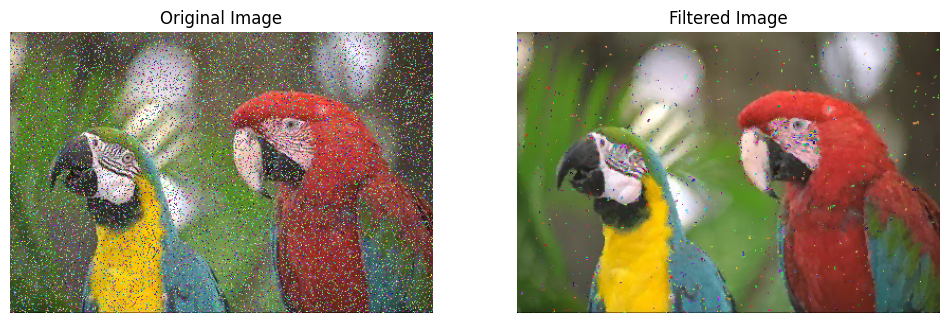

In [ ]:
filtered_vector_image2=vector_median_filter2(input_image_final,size=3)


# Display the original, corrupted, and denoised images
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(input_image_final)
plt.axis('off')


plt.subplot(1, 2, 2)
plt.title('Filtered Image')
plt.imshow(filtered_vector_image2)
plt.axis('off')

plt.show()

In [ ]:
def calculate_euclidean_norms(roi):
    norms_and_indices = []
    flattened_roi = roi.reshape((-1, 3))

    for j in range(roi.shape[0]):
        pixel = flattened_roi[j]
        euclidean_norm = np.linalg.norm(pixel)
        indices = j
        norms_and_indices.append((euclidean_norm, indices))

  # Sort based on Euclidean norms
    sortedarray = sorted(norms_and_indices, key=lambda x: x[0])

    # Find the median index
    median_index = len(sortedarray)//2

    # Get the RGB value at the median index
    median_rgb = flattened_roi[sortedarray[median_index][1]]

    return median_rgb



def vector_median_filter3(image,size):

    padding = size // 2
    padded_image = np.pad(image, ((padding, padding), (padding, padding), (0, 0)), mode='constant', constant_values=0)

    filtered_image = np.zeros_like(image)

    for i in range(image.shape[0] ):
        for j in range(image.shape[1]):
            # Extract the sizexsize region of interest (ROI) from the padded image
            roi = padded_image[i:i+size, j:j+size, :]
            rgb_value=calculate_euclidean_norms(roi)
            filtered_image[i, j] = rgb_value

    return filtered_image

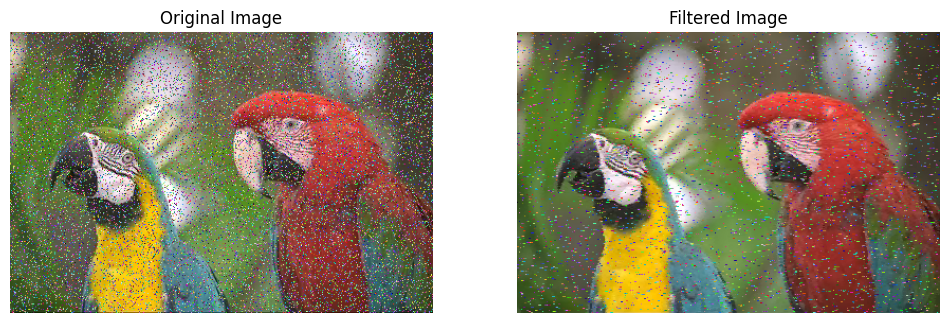

In [ ]:
filtered_vector_image3=vector_median_filter3(input_image_final,size=3)


# Display the original, corrupted, and denoised images
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(input_image_final)
plt.axis('off')


plt.subplot(1, 2, 2)
plt.title('Filtered Image')
plt.imshow(filtered_vector_image3)
plt.axis('off')

plt.show()

MSE for /content/drive/MyDrive/p5.jpg:
MSE Marginal Strategy Ordering: 12.442045739348371
MSE Lexicographical Ordering: 12.442045739348371
MSE Bitmix Ordering: 12.945701754385965
MSE Norm Ordering: 23.87905701754386


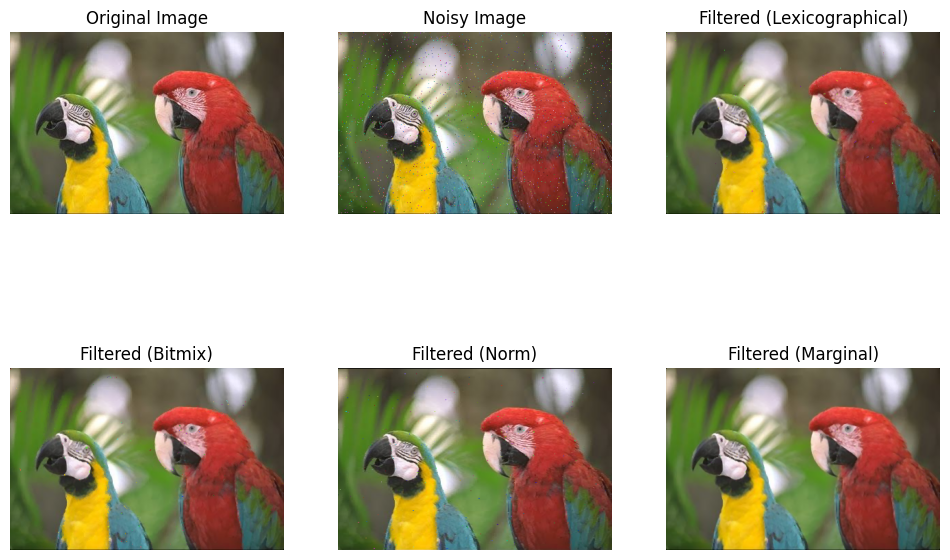

--------------------------------------------------
MSE for /content/drive/MyDrive/img1.jpg:
MSE Marginal Strategy Ordering: 12.824933369954428
MSE Lexicographical Ordering: 12.824933369954428
MSE Bitmix Ordering: 13.069538116455078
MSE Norm Ordering: 26.104989369710285


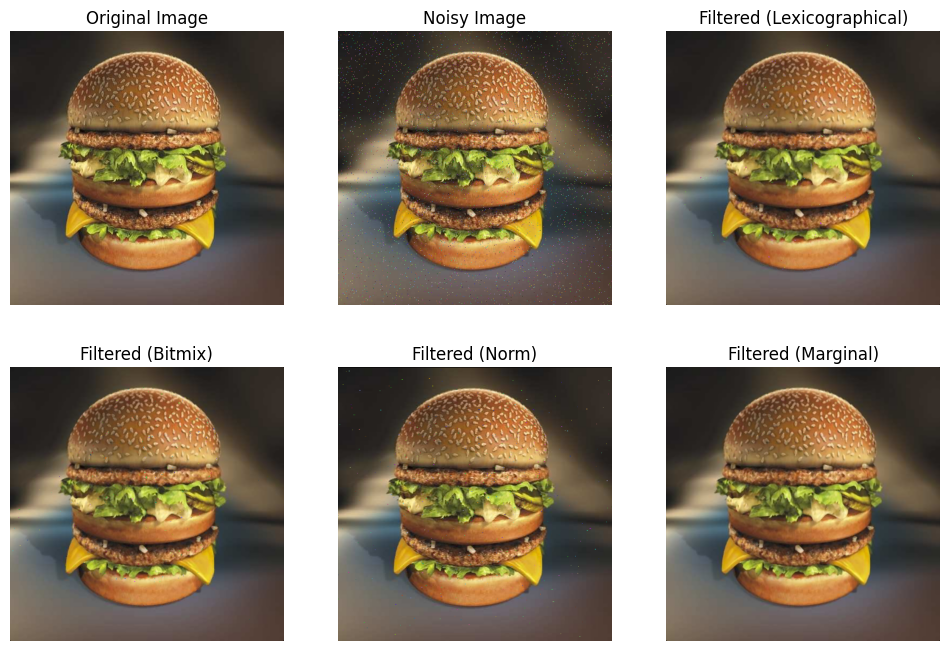

--------------------------------------------------
MSE for /content/drive/MyDrive/img2.jpg:
MSE Marginal Strategy Ordering: 19.55242042042042
MSE Lexicographical Ordering: 19.55242042042042
MSE Bitmix Ordering: 18.7703003003003
MSE Norm Ordering: 35.17738138138138


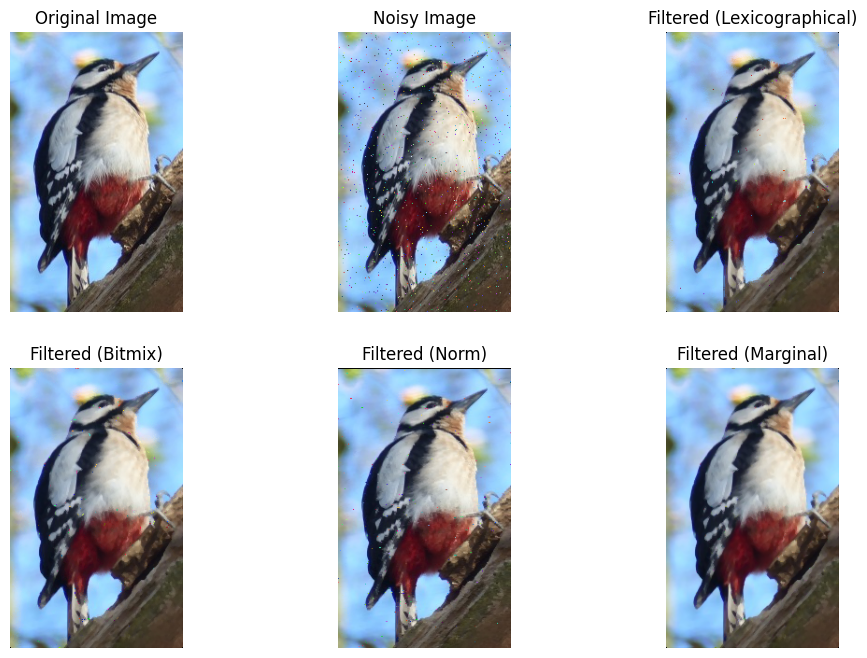

--------------------------------------------------
MSE for /content/drive/MyDrive/img3.png:
MSE Marginal Strategy Ordering: 23.26051498127341
MSE Lexicographical Ordering: 23.26051498127341
MSE Bitmix Ordering: 23.347306491885142
MSE Norm Ordering: 34.292986891385766


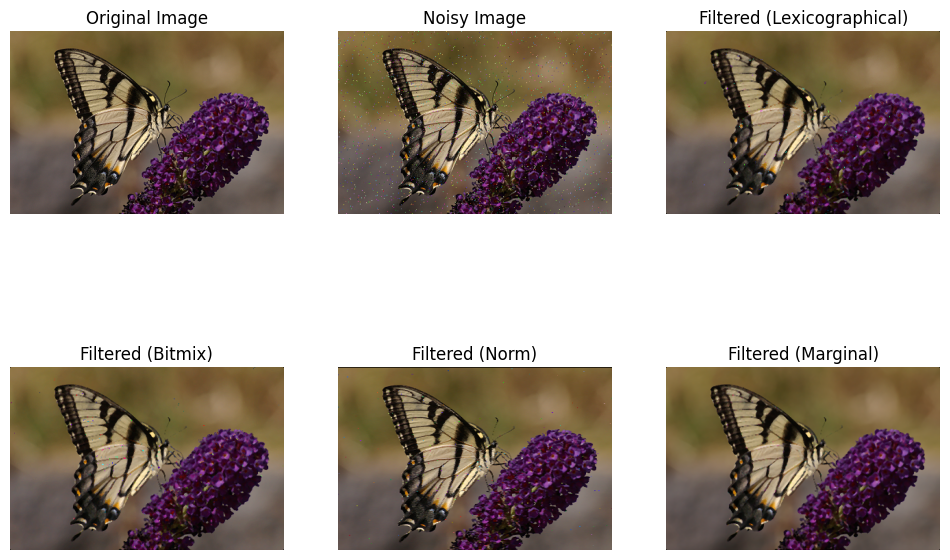

--------------------------------------------------
MSE for /content/drive/MyDrive/img4.jpg:
MSE Marginal Strategy Ordering: 19.589269002278645
MSE Lexicographical Ordering: 19.589269002278645
MSE Bitmix Ordering: 17.6400146484375
MSE Norm Ordering: 35.94281514485677


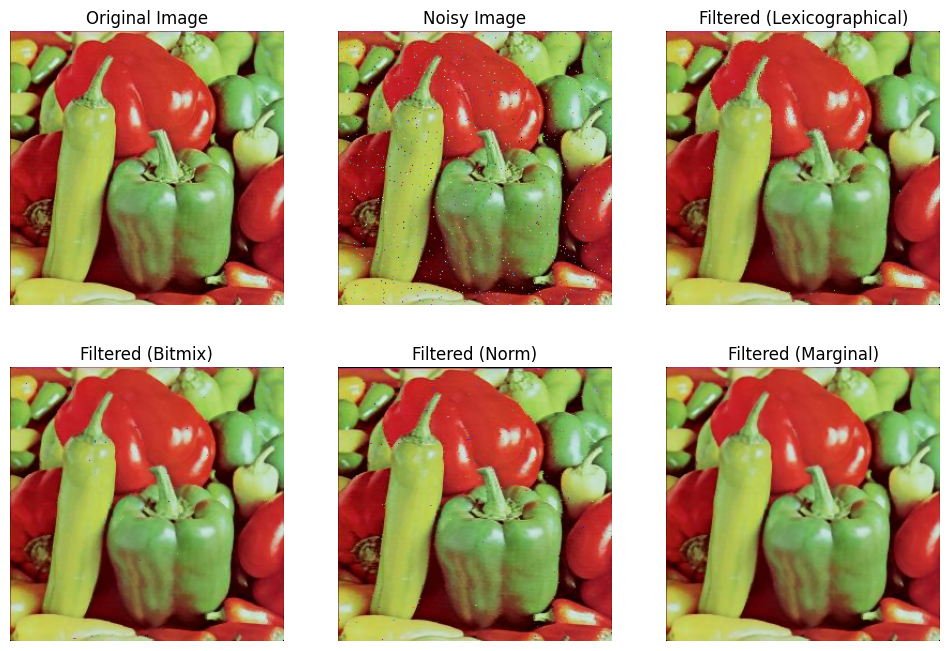

--------------------------------------------------
MSE for /content/drive/MyDrive/img5.png:
MSE Marginal Strategy Ordering: 10.567540740740741
MSE Lexicographical Ordering: 10.567540740740741
MSE Bitmix Ordering: 10.0227012345679
MSE Norm Ordering: 24.778414814814816


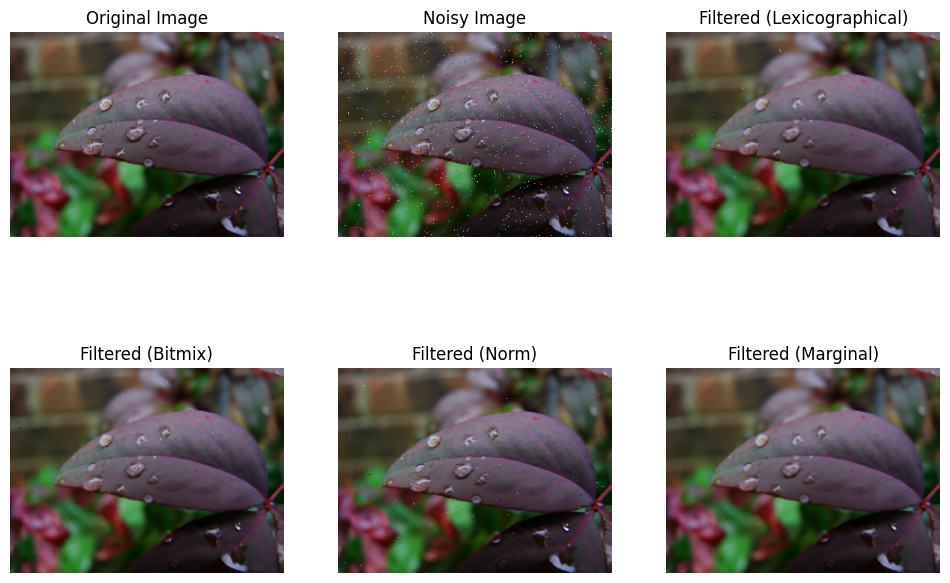

--------------------------------------------------
MSE for /content/drive/MyDrive/img6.jpg:
MSE Marginal Strategy Ordering: 18.13689676920573
MSE Lexicographical Ordering: 18.13689676920573
MSE Bitmix Ordering: 17.657755533854168
MSE Norm Ordering: 31.89391581217448


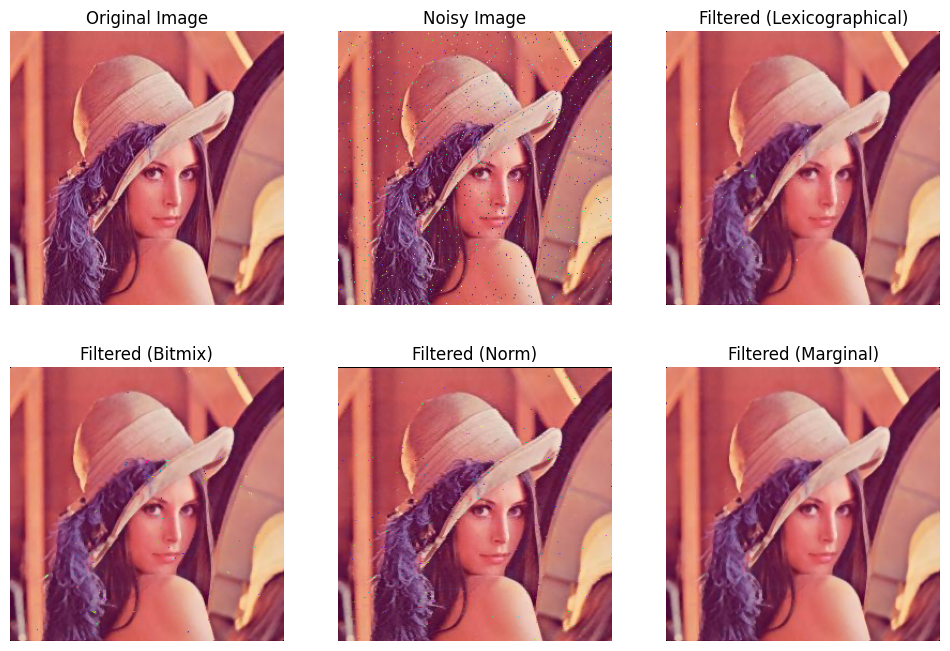

--------------------------------------------------
MSE for /content/drive/MyDrive/img7.jpg:
MSE Marginal Strategy Ordering: 56.81513468424479
MSE Lexicographical Ordering: 56.81513468424479
MSE Bitmix Ordering: 56.1593271891276
MSE Norm Ordering: 76.30688985188802


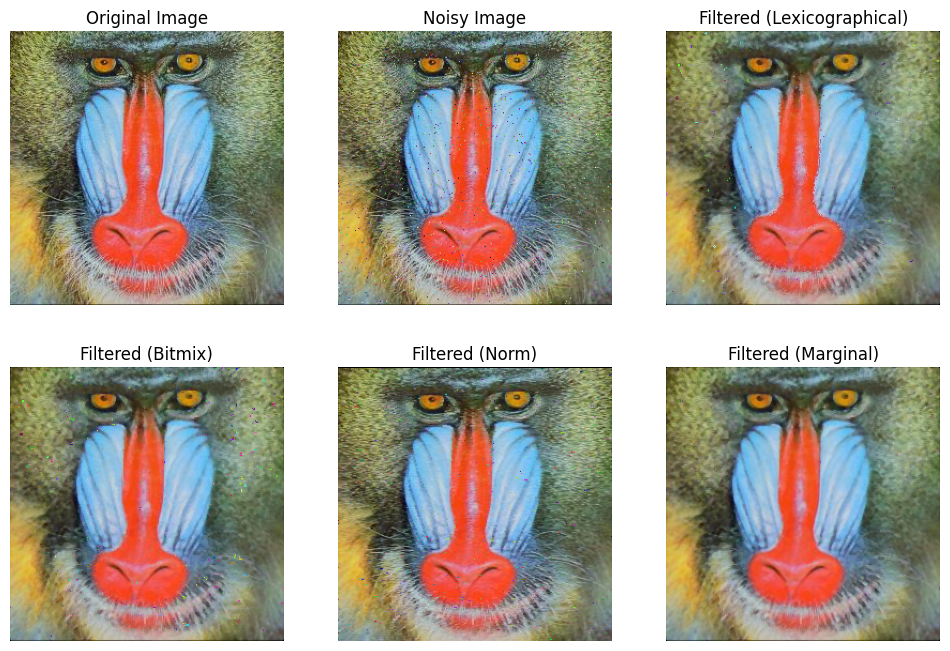

--------------------------------------------------
MSE for /content/drive/MyDrive/img8.jpg:
MSE Marginal Strategy Ordering: 37.019933333333334
MSE Lexicographical Ordering: 37.019933333333334
MSE Bitmix Ordering: 35.83732222222222
MSE Norm Ordering: 58.17924444444444


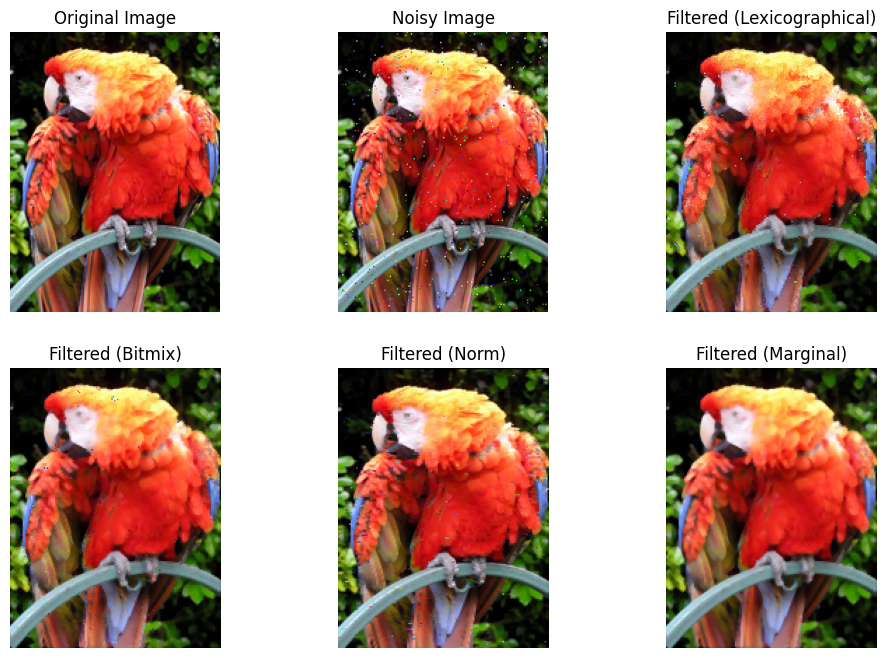

--------------------------------------------------
MSE for /content/drive/MyDrive/img9.jpg:
MSE Marginal Strategy Ordering: 12.001169840494791
MSE Lexicographical Ordering: 12.001169840494791
MSE Bitmix Ordering: 11.914342244466146
MSE Norm Ordering: 27.778096516927082


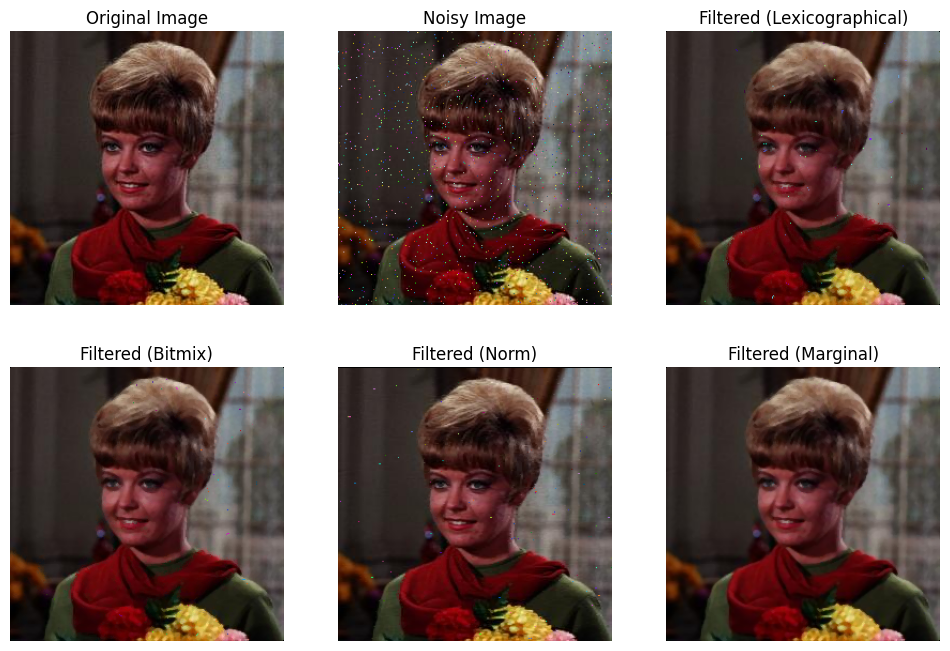

--------------------------------------------------


In [ ]:

def calculate_mse(original_image, filtered_image):
    return np.mean((original_image - filtered_image) ** 2)

# Load 10 different images (replace file paths accordingly)
image_paths = ['/content/drive/MyDrive/p5.jpg', '/content/drive/MyDrive/img1.jpg', '/content/drive/MyDrive/img2.jpg', '/content/drive/MyDrive/img3.png', '/content/drive/MyDrive/img4.jpg',
               '/content/drive/MyDrive/img5.png', '/content/drive/MyDrive/img6.jpg', '/content/drive/MyDrive/img7.jpg', '/content/drive/MyDrive/img8.jpg', '/content/drive/MyDrive/img9.jpg']

# Track MSE values for each filter
mse_results = {
    "Lexicographical": [],
    "Bitmix": [],
    "Norm": [],
    "Marginal": []
}


for path in image_paths:
    original_image = cv2.imread(path)
    original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    noisy_image = add_colored_large_salt_and_pepper_noise(original_image_rgb,0.02, 1)

    # Apply each median filter to the noisy image
    filtered_lexicographical = vector_median_filter(noisy_image,size=3)
    filtered_bitmix = vector_median_filter2(noisy_image,size=3)
    filtered_norm = vector_median_filter3(noisy_image,size=3)
    filtered_marginal = median_filter_custom(noisy_image,size=3)

    # Calculate MSE for each filter
    mse_lexicographical = calculate_mse(original_image_rgb, filtered_lexicographical)
    mse_bitmix = calculate_mse(original_image_rgb, filtered_bitmix)
    mse_norm = calculate_mse(original_image_rgb, filtered_norm)
    mse_marginal= calculate_mse(original_image_rgb, filtered_marginal)

    print(f"MSE for {path}:")
    print(f"MSE Marginal Strategy Ordering: {mse_lexicographical}")
    print(f"MSE Lexicographical Ordering: {mse_lexicographical}")
    print(f"MSE Bitmix Ordering: {mse_bitmix}")
    print(f"MSE Norm Ordering: {mse_norm}")

    mse_results["Lexicographical"].append(mse_lexicographical)
    mse_results["Bitmix"].append(mse_bitmix)
    mse_results["Norm"].append(mse_norm)
    mse_results["Marginal"].append(mse_marginal)


    # Plot images and save them
    plt.figure(figsize=(12, 8))

    plt.subplot(2, 3, 1)
    plt.imshow(original_image_rgb)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(2, 3, 2)
    plt.imshow(noisy_image)
    plt.title('Noisy Image')
    plt.axis('off')

    plt.subplot(2, 3, 3)
    plt.imshow(filtered_lexicographical)
    plt.title('Filtered (Lexicographical)')
    plt.axis('off')

    plt.subplot(2, 3, 4)
    plt.imshow(filtered_bitmix)
    plt.title('Filtered (Bitmix)')
    plt.axis('off')

    plt.subplot(2, 3, 5)
    plt.imshow(filtered_norm)
    plt.title('Filtered (Norm)')
    plt.axis('off')

    plt.subplot(2, 3, 6)
    plt.imshow(filtered_marginal)
    plt.title('Filtered (Marginal)')
    plt.axis('off')

    plt.show()
    print("-" * 50)



**Question 5a**

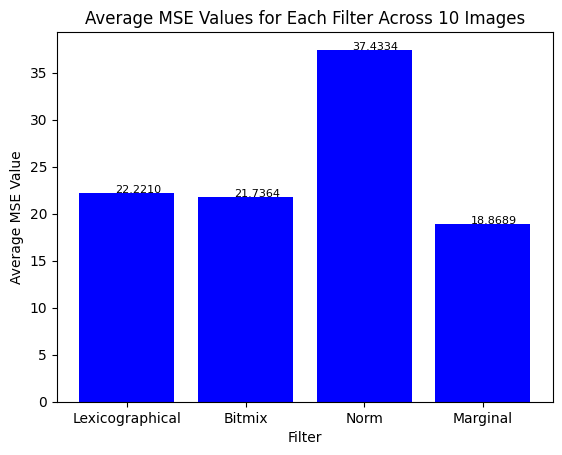

In [ ]:
# Calculate average MSE values for each filter
avg_mse_results = {
    "Lexicographical": np.mean(mse_results["Lexicographical"]),
    "Bitmix": np.mean(mse_results["Bitmix"]),
    "Norm": np.mean(mse_results["Norm"]),
    "Marginal": np.mean(mse_results["Marginal"])
}

# Plot a bar graph showing average MSE values for each filter with values on top
fig, ax = plt.subplots()
bars = ax.bar(avg_mse_results.keys(), avg_mse_results.values(), color='blue')

# Display average MSE values on top of the bars
for bar, avg_mse_value in zip(bars, avg_mse_results.values()):
    ax.text(bar.get_x() + bar.get_width() / 2 - 0.1, bar.get_height() + 0.01,
            f'{avg_mse_value:.4f}', fontsize=8, color='black')

ax.set_title('Average MSE Values for Each Filter Across 10 Images')
ax.set_xlabel('Filter')
ax.set_ylabel('Average MSE Value')
plt.show()

**Question 5b**

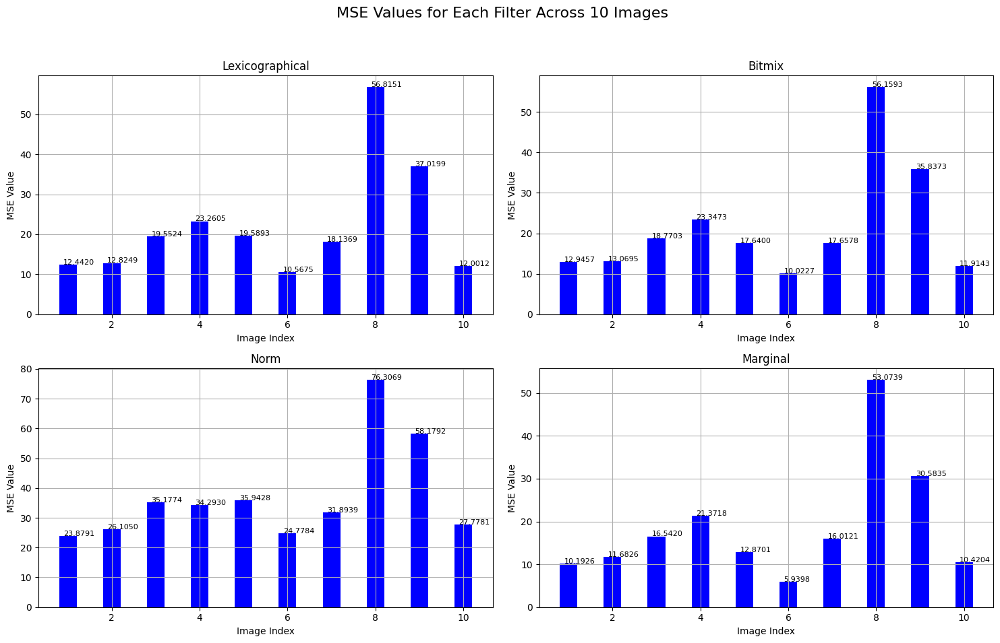

In [ ]:
# Plot separate bar graphs for each filter with MSE values on top
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('MSE Values for Each Filter Across 10 Images', fontsize=16)

for ax, (filter_name, mse_values) in zip(axes.flat, mse_results.items()):
    index = np.arange(1, 11)
    bar_width = 0.4
    bars = ax.bar(index, mse_values, width=bar_width, color='blue')

    # Display MSE values on top of the bars
    for bar, mse_value in zip(bars, mse_values):
        ax.text(bar.get_x() + bar.get_width() / 2 - 0.1, bar.get_height() + 0.01,
                f'{mse_value:.4f}', fontsize=8, color='black')

    ax.set_title(filter_name)
    ax.set_xlabel('Image Index')
    ax.set_ylabel('MSE Value')
    ax.grid(True)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

**Question 5c**

In [ ]:
def process_images_diffrent_arguments(image_paths, noise_probability,size,colorspace,printimages):
    # Track MSE values for each filter
    mse_results = {
        "Lexicographical": [],
        "Bitmix": [],
        "Norm": [],
        "Marginal": []
    }

    for path in image_paths:
        original_image = cv2.imread(path)
        if( colorspace=="rgb"):
          original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
        if(colorspace=="lab"):
          original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2LAB)
        noisy_image = add_colored_large_salt_and_pepper_noise(original_image_rgb, noise_probability, 1)

        # Apply each median filter to the noisy image
        filtered_lexicographical = vector_median_filter(noisy_image,size)
        filtered_bitmix = vector_median_filter2(noisy_image,size)
        filtered_norm = vector_median_filter3(noisy_image,size)
        filtered_marginal = median_filter_custom(noisy_image,size)

        # Calculate MSE for each filter
        mse_lexicographical = calculate_mse(original_image_rgb, filtered_lexicographical)
        mse_bitmix = calculate_mse(original_image_rgb, filtered_bitmix)
        mse_norm = calculate_mse(original_image_rgb, filtered_norm)
        mse_marginal = calculate_mse(original_image_rgb, filtered_marginal)

        mse_results["Lexicographical"].append(mse_lexicographical)
        mse_results["Bitmix"].append(mse_bitmix)
        mse_results["Norm"].append(mse_norm)
        mse_results["Marginal"].append(mse_marginal)

        if(printimages):

          print(f"MSE for {path}:")
          print(f"MSE Marginal Strategy Ordering: {mse_lexicographical}")
          print(f"MSE Lexicographical Ordering: {mse_lexicographical}")
          print(f"MSE Bitmix Ordering: {mse_bitmix}")
          print(f"MSE Norm Ordering: {mse_norm}")

          # Plot images and save them
          plt.figure(figsize=(12, 8))

          plt.subplot(2, 3, 1)
          plt.imshow(original_image_rgb)
          plt.title('Original Image')
          plt.axis('off')

          plt.subplot(2, 3, 2)
          plt.imshow(noisy_image)
          plt.title('Noisy Image')
          plt.axis('off')

          plt.subplot(2, 3, 3)
          plt.imshow(filtered_lexicographical)
          plt.title('Filtered (Lexicographical)')
          plt.axis('off')

          plt.subplot(2, 3, 4)
          plt.imshow(filtered_bitmix)
          plt.title('Filtered (Bitmix)')
          plt.axis('off')

          plt.subplot(2, 3, 5)
          plt.imshow(filtered_norm)
          plt.title('Filtered (Norm)')
          plt.axis('off')

          plt.subplot(2, 3, 6)
          plt.imshow(filtered_marginal)
          plt.title('Filtered (Marginal)')
          plt.axis('off')

          plt.show()
          print("-" * 50)





    return mse_results



In [ ]:
# Define a range of noise probabilities
noise_probabilities = [0.01, 0.02, 0.03, 0.04, 0.05]

# Results dictionary to store MSE values for each noise probability
all_results = {}

# Iterate over each noise probability
for noise_prob in noise_probabilities:

    # Process images for the current noise probability
    mse_results2 = process_images_diffrent_arguments(image_paths, noise_prob,size=3,colorspace="rgb",printimages=False)
    avg_mse_results2 = {
    "Lexicographical": np.mean(mse_results2["Lexicographical"]),
    "Bitmix": np.mean(mse_results2["Bitmix"]),
    "Norm": np.mean(mse_results2["Norm"]),
    "Marginal": np.mean(mse_results2["Marginal"])
    }

    # Store results in the dictionary
    all_results[noise_prob] = avg_mse_results2

# Display or analyze the results as needed
for noise_prob, avg_mse_results2 in all_results.items():
    print(f"Filters Avrage mse results for noise probability {noise_prob}:")
    # Print or analyze the MSE values in results dictionary
    # For example:
    print(avg_mse_results2)
    print("-" * 50)


Filters Avrage mse results for noise probability 0.01:
{'Lexicographical': 21.925697976615446, 'Bitmix': 21.419454853578113, 'Norm': 37.22371250532335, 'Marginal': 18.58004281867796}
--------------------------------------------------
Filters Avrage mse results for noise probability 0.02:
{'Lexicographical': 22.22864868031705, 'Bitmix': 21.762587243458384, 'Norm': 37.4564782358492, 'Marginal': 18.897579130308266}
--------------------------------------------------
Filters Avrage mse results for noise probability 0.03:
{'Lexicographical': 22.493843630775046, 'Bitmix': 22.08191146081871, 'Norm': 37.72593531800078, 'Marginal': 19.164557141376175}
--------------------------------------------------
Filters Avrage mse results for noise probability 0.04:
{'Lexicographical': 22.76493555440733, 'Bitmix': 22.418364340630582, 'Norm': 38.00466159300554, 'Marginal': 19.486368638605573}
--------------------------------------------------
Filters Avrage mse results for noise probability 0.05:
{'Lexicogr

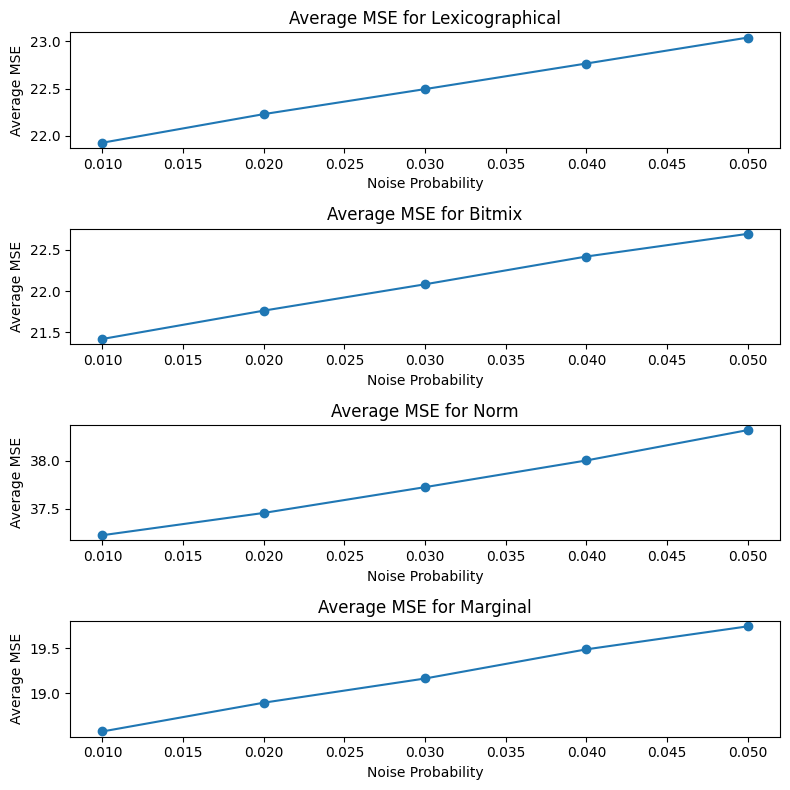

In [ ]:

# Extract noise probabilities and filter names
noise_probabilities = sorted(all_results.keys())
filter_names = list(all_results[noise_probabilities[0]].keys())

# Create subplots for each filter
num_filters = len(filter_names)
fig, axes = plt.subplots(nrows=num_filters, ncols=1, figsize=(8, 2 * num_filters))

# Plot average MSE results for each filter
for i, filter_name in enumerate(filter_names):
    mse_avg_values = [all_results[noise_prob][filter_name] for noise_prob in noise_probabilities]

    axes[i].plot(noise_probabilities, mse_avg_values, marker='o')
    axes[i].set_title(f'Average MSE for {filter_name}')
    axes[i].set_xlabel('Noise Probability')
    axes[i].set_ylabel('Average MSE')

plt.tight_layout()
plt.show()


**Question 5d**

In [ ]:
# Define a range of size probabilities
size_probabilities = [3,5,7]

# Results dictionary to store MSE values for each noise probability
all_results2 = {}

# Iterate over each noise probability
for size in size_probabilities:

    # Process images for the current size
    mse_results3 = process_images_diffrent_arguments(image_paths, 0.02,size,colorspace="rgb",printimages=False)
    avg_mse_results3 = {
    "Lexicographical": np.mean(mse_results3["Lexicographical"]),
    "Bitmix": np.mean(mse_results3["Bitmix"]),
    "Norm": np.mean(mse_results3["Norm"]),
    "Marginal": np.mean(mse_results3["Marginal"])
    }

    # Store results in the dictionary
    all_results2[size] = avg_mse_results3

# Display or analyze the results as needed
for size, avg_mse_results3 in all_results2.items():
    print(f"Filters Avrage mse results for kernel of size {size}:")
    # Print or analyze the MSE values in results dictionary
    # For example:
    print(avg_mse_results3)
    print("-" * 50)

Filters Avrage mse results for kerneol of size 3:
{'Lexicographical': 22.23150506875492, 'Bitmix': 21.755752130769068, 'Norm': 37.457115112263615, 'Marginal': 18.889131598308115}
--------------------------------------------------
Filters Avrage mse results for kerneol of size 5:
{'Lexicographical': 33.406742683305744, 'Bitmix': 32.800989383367856, 'Norm': 49.79114974450675, 'Marginal': 29.102571887433704}
--------------------------------------------------
Filters Avrage mse results for kerneol of size 7:
{'Lexicographical': 40.14656847616898, 'Bitmix': 39.521996875226556, 'Norm': 56.85737416284785, 'Marginal': 35.44981626591023}
--------------------------------------------------


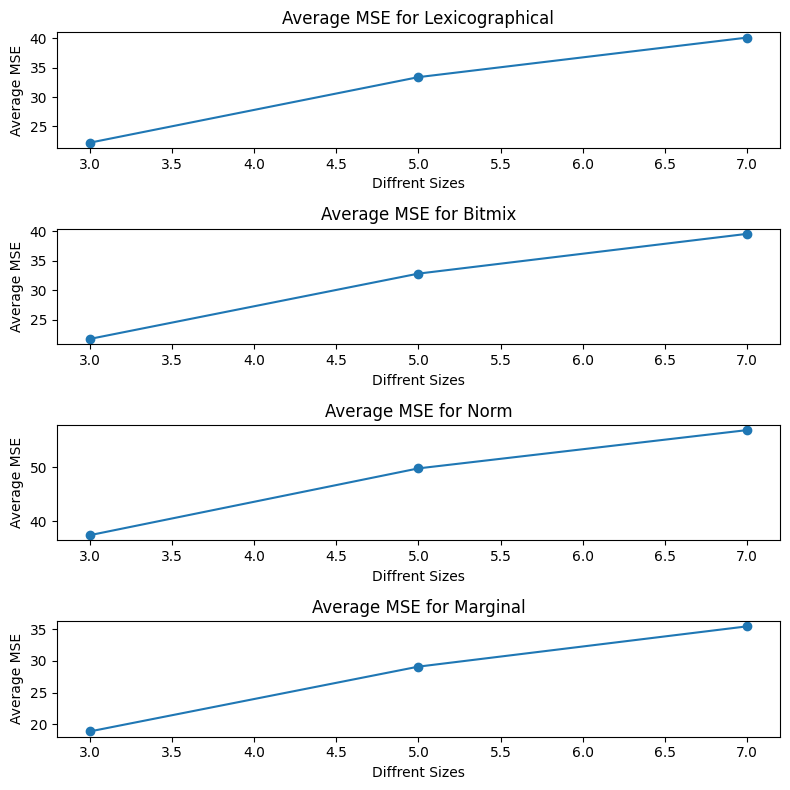

In [ ]:
# Extract noise probabilities and filter names
size_probabilities = sorted(all_results2.keys())
filter_names2 = list(all_results2[size_probabilities[0]].keys())

# Create subplots for each filter
num_filters2 = len(filter_names2)
fig, axes = plt.subplots(nrows=num_filters2, ncols=1, figsize=(8, 2 * num_filters2))

# Plot average MSE results for each filter
for i, filter_name in enumerate(filter_names2):
    mse_avg_values = [all_results2[size][filter_name] for size in size_probabilities]

    axes[i].plot(size_probabilities, mse_avg_values, marker='o')
    axes[i].set_title(f'Average MSE for {filter_name}')
    axes[i].set_xlabel('Diffrent Sizes')
    axes[i].set_ylabel('Average MSE')

plt.tight_layout()
plt.show()


**Question 5e**

MSE for /content/drive/MyDrive/p5.jpg:
MSE Marginal Strategy Ordering: 5.002167919799499
MSE Lexicographical Ordering: 5.002167919799499
MSE Bitmix Ordering: 6.3953164160401
MSE Norm Ordering: 9.780632832080201


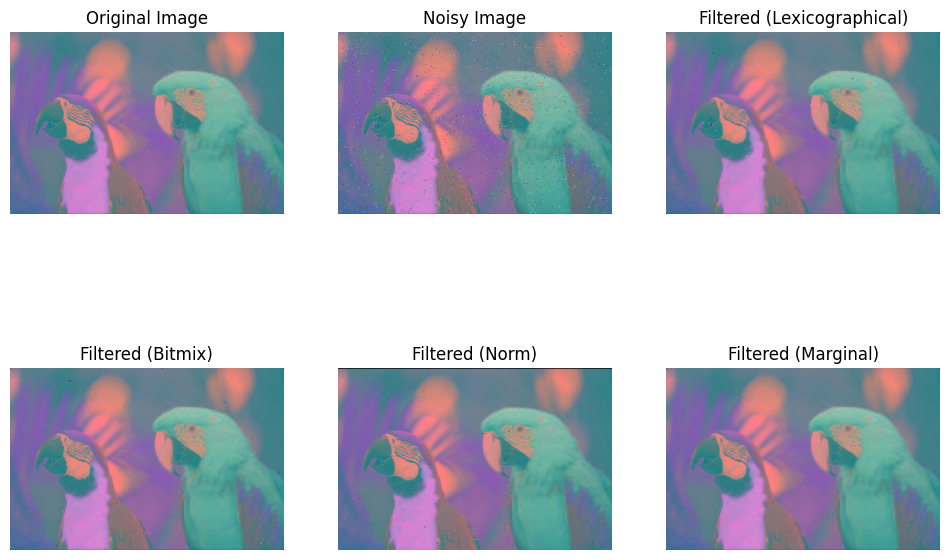

--------------------------------------------------
MSE for /content/drive/MyDrive/img1.jpg:
MSE Marginal Strategy Ordering: 4.914524078369141
MSE Lexicographical Ordering: 4.914524078369141
MSE Bitmix Ordering: 6.008912404378255
MSE Norm Ordering: 10.625509897867838


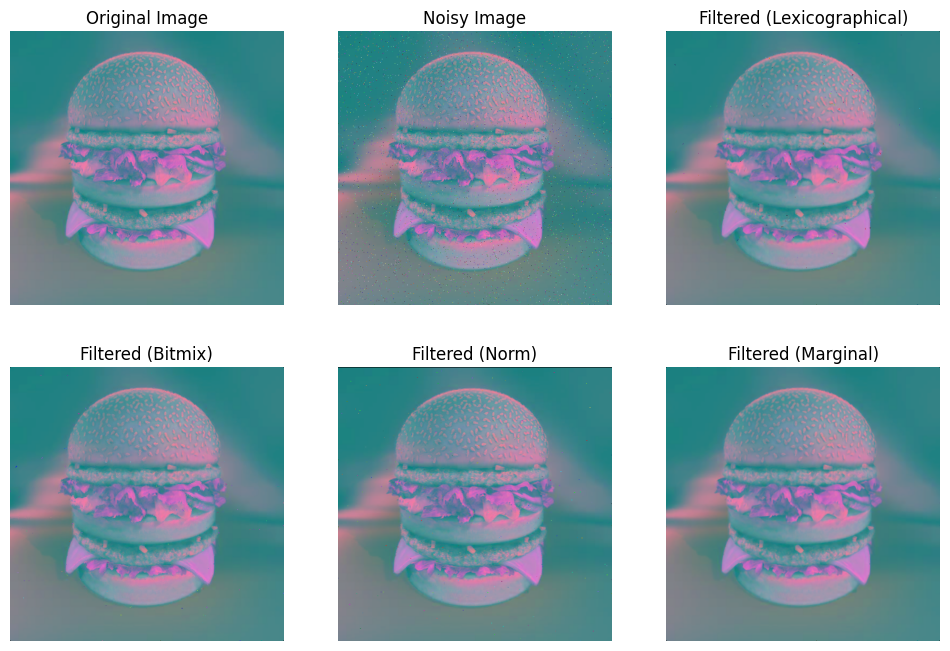

--------------------------------------------------
MSE for /content/drive/MyDrive/img2.jpg:
MSE Marginal Strategy Ordering: 7.40836036036036
MSE Lexicographical Ordering: 7.40836036036036
MSE Bitmix Ordering: 10.549471471471472
MSE Norm Ordering: 14.295645645645646


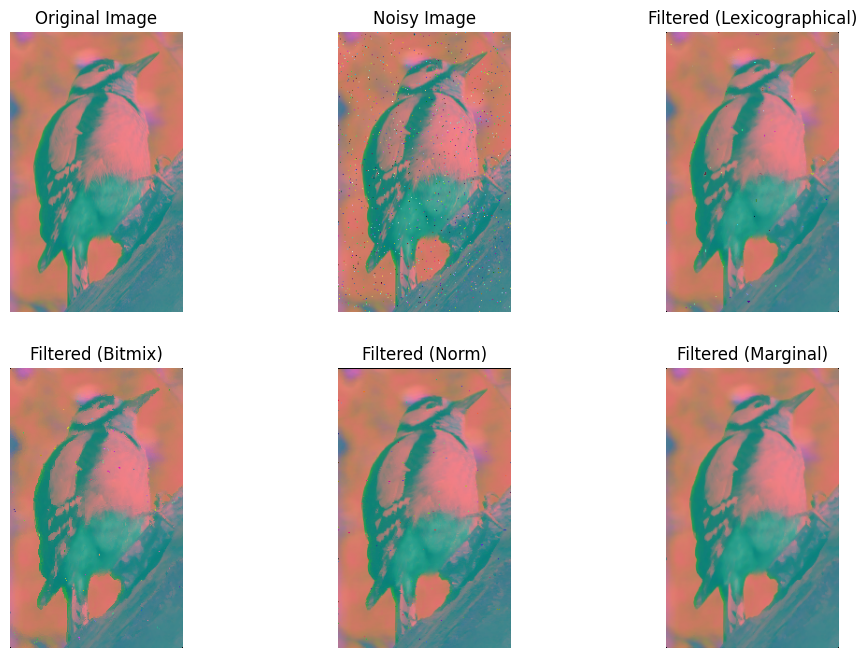

--------------------------------------------------
MSE for /content/drive/MyDrive/img3.png:
MSE Marginal Strategy Ordering: 12.895930087390761
MSE Lexicographical Ordering: 12.895930087390761
MSE Bitmix Ordering: 14.912278401997503
MSE Norm Ordering: 20.065461922596754


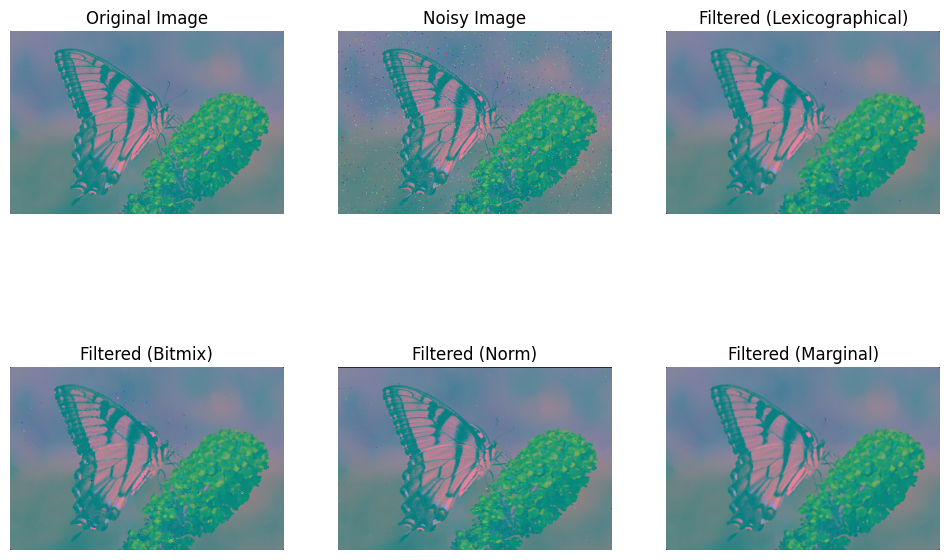

--------------------------------------------------
MSE for /content/drive/MyDrive/img4.jpg:
MSE Marginal Strategy Ordering: 7.435282389322917
MSE Lexicographical Ordering: 7.435282389322917
MSE Bitmix Ordering: 13.518946329752604
MSE Norm Ordering: 18.329345703125


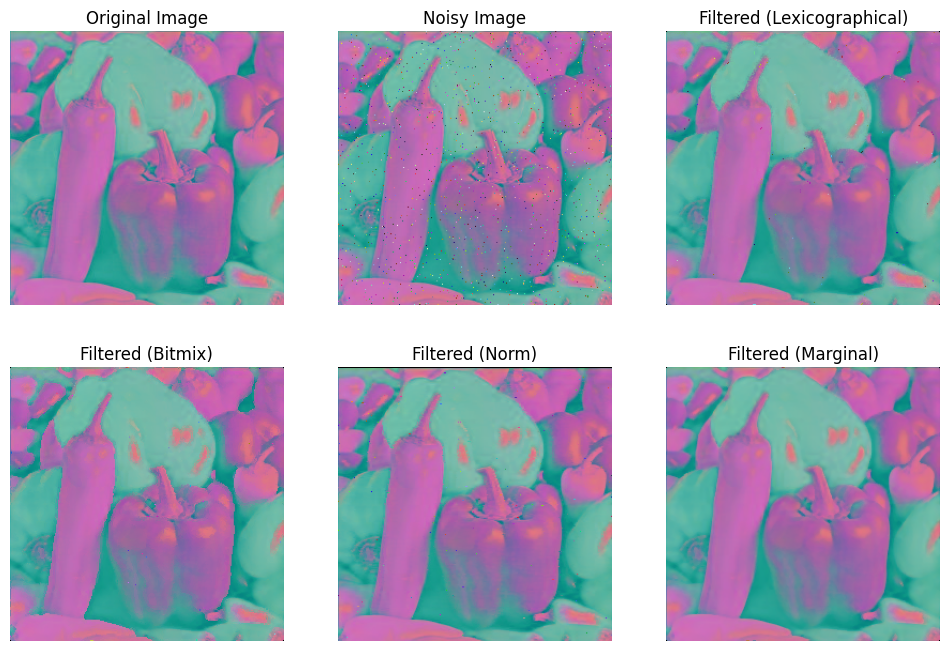

--------------------------------------------------
MSE for /content/drive/MyDrive/img5.png:
MSE Marginal Strategy Ordering: 5.382345679012346
MSE Lexicographical Ordering: 5.382345679012346
MSE Bitmix Ordering: 9.816024691358026
MSE Norm Ordering: 14.338246913580248


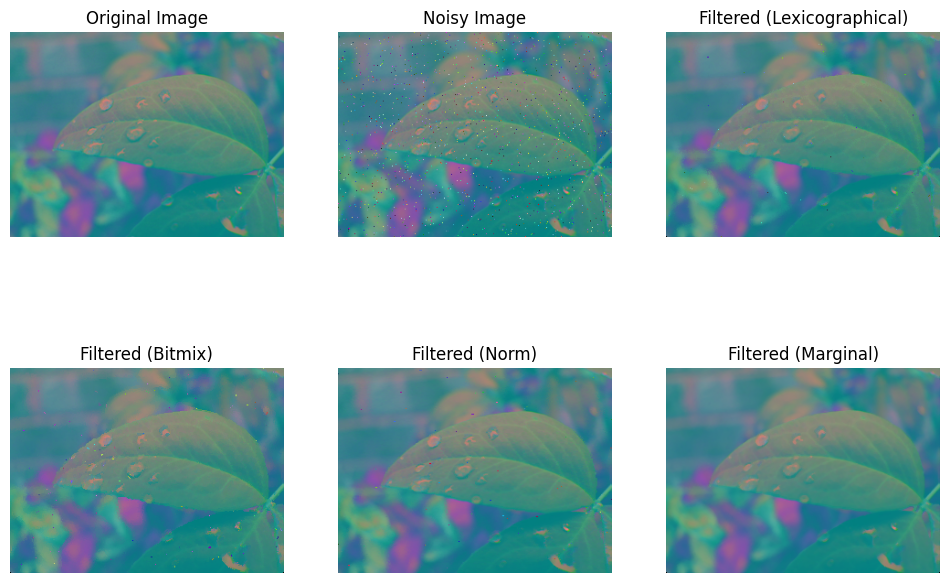

--------------------------------------------------
MSE for /content/drive/MyDrive/img6.jpg:
MSE Marginal Strategy Ordering: 6.4352162679036455
MSE Lexicographical Ordering: 6.4352162679036455
MSE Bitmix Ordering: 8.565536499023438
MSE Norm Ordering: 12.547719319661459


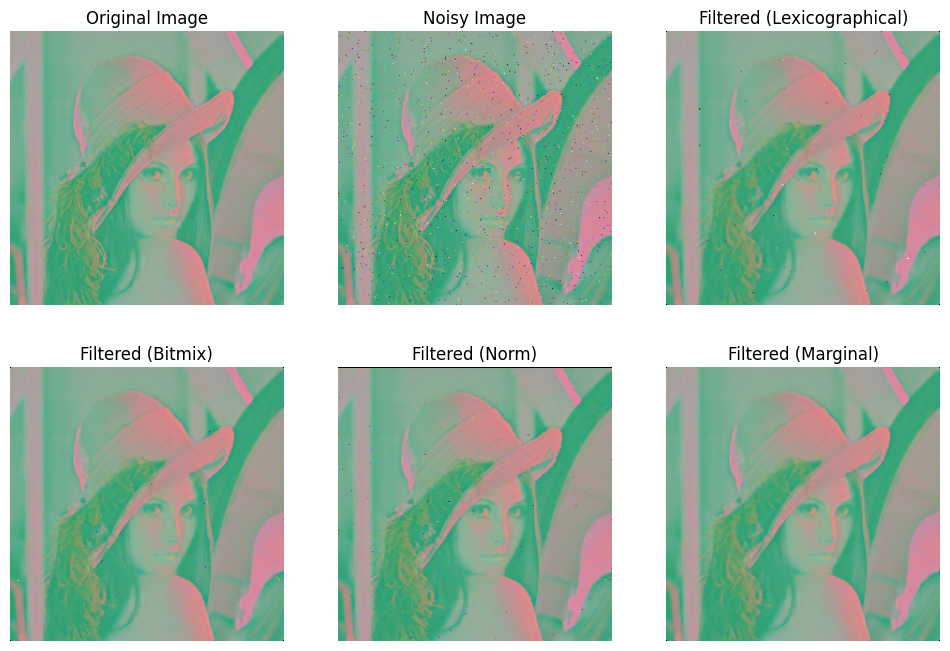

--------------------------------------------------
MSE for /content/drive/MyDrive/img7.jpg:
MSE Marginal Strategy Ordering: 21.499730428059895
MSE Lexicographical Ordering: 21.499730428059895
MSE Bitmix Ordering: 22.438028971354168
MSE Norm Ordering: 29.107869466145832


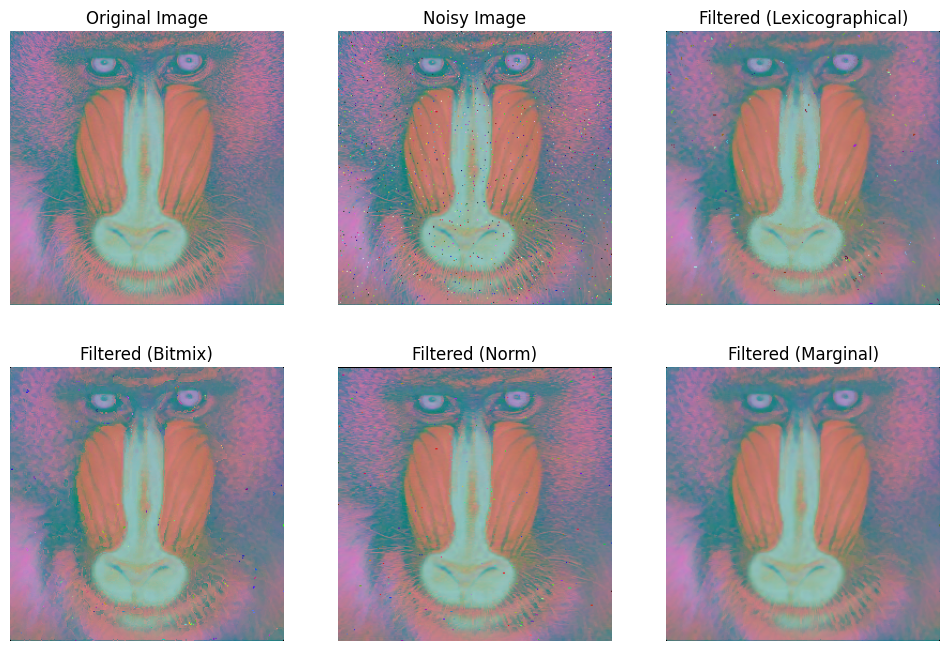

--------------------------------------------------
MSE for /content/drive/MyDrive/img8.jpg:
MSE Marginal Strategy Ordering: 20.534211111111112
MSE Lexicographical Ordering: 20.534211111111112
MSE Bitmix Ordering: 27.688377777777777
MSE Norm Ordering: 37.897777777777776


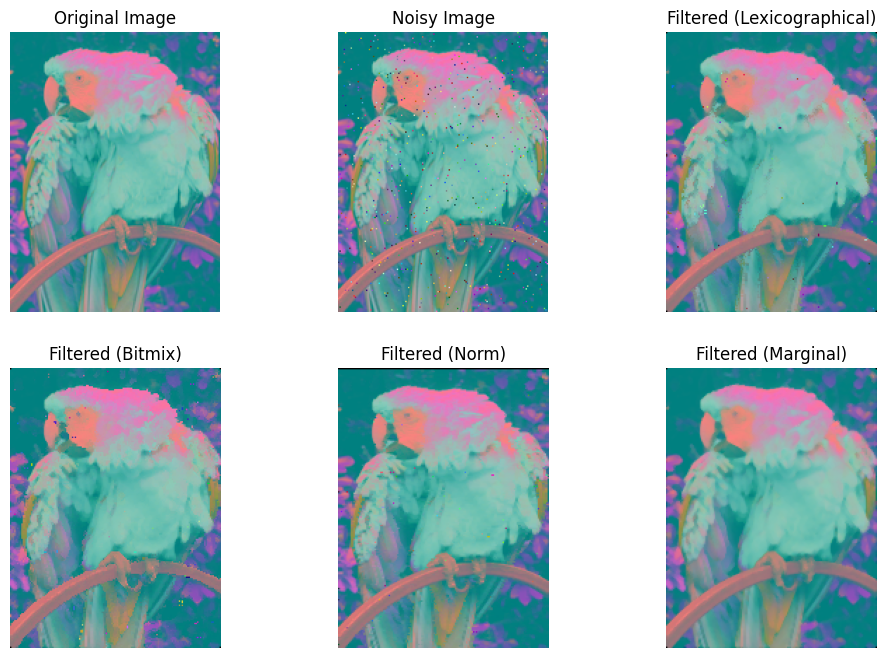

--------------------------------------------------
MSE for /content/drive/MyDrive/img9.jpg:
MSE Marginal Strategy Ordering: 4.816080729166667
MSE Lexicographical Ordering: 4.816080729166667
MSE Bitmix Ordering: 6.398661295572917
MSE Norm Ordering: 12.386403401692709


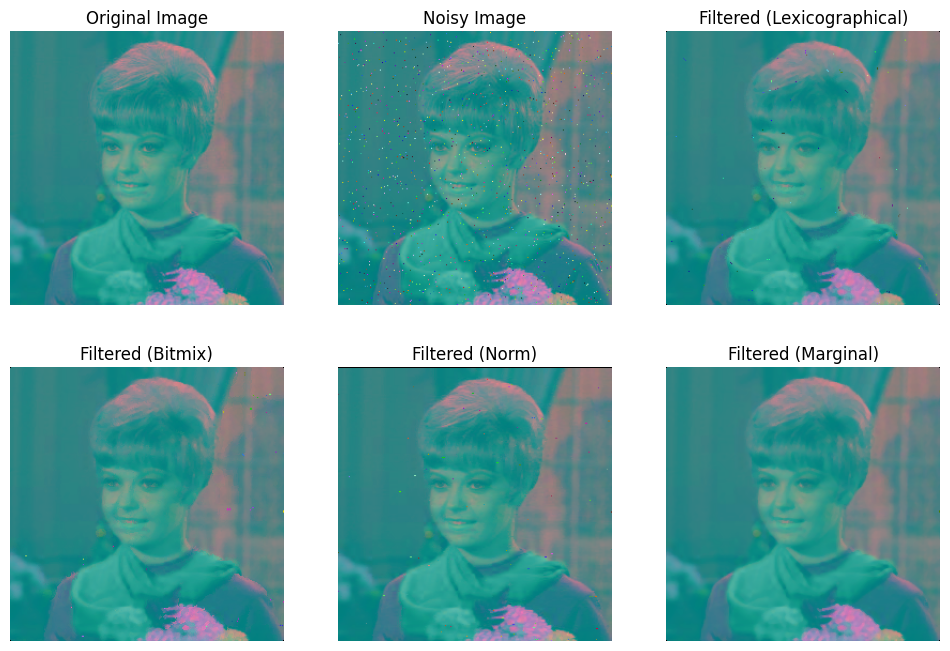

--------------------------------------------------


In [ ]:
mse_results4 = process_images_diffrent_arguments(image_paths, 0.02, size=3, colorspace="lab", printimages=True)


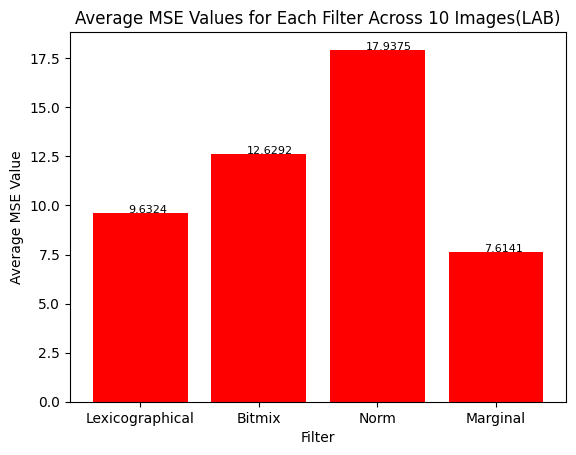

In [ ]:
# Calculate average MSE values for each filter
avg_mse_results4 = {
    "Lexicographical": np.mean(mse_results4["Lexicographical"]),
    "Bitmix": np.mean(mse_results4["Bitmix"]),
    "Norm": np.mean(mse_results4["Norm"]),
    "Marginal": np.mean(mse_results4["Marginal"])
}

# Plot a bar graph showing average MSE values for each filter with values on top
fig, ax = plt.subplots()
bars = ax.bar(avg_mse_results4.keys(), avg_mse_results4.values(), color='red')

# Display average MSE values on top of the bars
for bar, avg_mse_value in zip(bars, avg_mse_results4.values()):
    ax.text(bar.get_x() + bar.get_width() / 2 - 0.1, bar.get_height() + 0.01,
            f'{avg_mse_value:.4f}', fontsize=8, color='black')

ax.set_title('Average MSE Values for Each Filter Across 10 Images(LAB)')
ax.set_xlabel('Filter')
ax.set_ylabel('Average MSE Value')
plt.show()